In [1]:
%matplotlib inline
%reload_ext autoreload

In [2]:
import matplotlib.pyplot as plt
import numpy as np
import xarray as xr
import seaborn as sns
import logging

FORMAT = "%(asctime)s %(message)s"

logging.basicConfig(level="INFO", format=FORMAT, datefmt="%d-%b-%y %H:%M:%S")
sns.set_context("talk")

In [3]:
epoch_key = 'Jaq', 3, 12

In [4]:
import cupy as cp

mempool = cp.get_default_memory_pool()
pinned_mempool = cp.get_default_pinned_memory_pool()

# You can clear the memory pool by calling `free_all_blocks`.
mempool.free_all_blocks()
pinned_mempool.free_all_blocks()

In [5]:
from src.load_data import load_data


data = load_data(epoch_key,
                 position_to_linearize=['nose_x', 'nose_y'],
                 max_distance_from_well=30,
                 min_distance_traveled=50,
                 )

04-Mar-22 17:09:01 Loading position info...
04-Mar-22 17:09:49 Loading multiunit...
04-Mar-22 17:10:08 Loading spikes...
04-Mar-22 17:10:13 Finding ripple times...


In [22]:
(data['is_ripple'].values[:-1] & data['is_ripple'].values[1:]).squeeze().mean()

0.021376740537360266

In [22]:
from replay_identification.discrete_state_transition import fit_discrete_state_transition_no_speed
from statsmodels.tsa.tsatools import lagmat

is_training = (data['is_descending'].values.squeeze() & (speed > 4)) | (~data['is_ripple'].values.squeeze() & (speed <= 4))
speed = data['position_info'].nose_vel.values.squeeze()
lagged_speed = lagmat(speed, maxlag=1).squeeze()
diagonal = fit_discrete_state_transition_no_speed(speed, is_training, penalty=1e-10)(lagged_speed)

In [17]:
diagonal[0][0]

0.020624872370958724

In [18]:
diagonal[0][1]

0.9995420567348391

In [ ]:
speed = data['position_info'].nose_vel.values.squeeze()
lagged_speed = lagmat(speed, maxlag=1).squeeze()
diagonal = fit_discrete_state_transition_no_speed(speed, data['is_ripple'].values.squeeze(), penalty=1e-10)(lagged_speed)

In [6]:
import numpy as np

detector_parameters = {
    'movement_var': 6.0,
    'replay_speed': 1,
    'place_bin_size': 2.0,
    'spike_model_knot_spacing': 12.0,
    'spike_model_penalty': 1E-5,
    'movement_state_transition_type': 'random_walk',
    'multiunit_model_kwargs': {
        'mark_std': 24.0, 'position_std': 4.0, 'block_size': 100},
    'discrete_state_transition_type': 'constant',
    'discrete_diagonal': np.array([0.02, 0.98])
}

In [7]:
from replay_identification import ReplayDetector
from src.parameters import WTRACK_EDGE_ORDER, WTRACK_EDGE_SPACING


non_local_detector = ReplayDetector(**detector_parameters)
logging.info(non_local_detector)

non_local_detector.fit(
    is_ripple=data['is_ripple'],
    is_training=np.ones_like(data['position_info'].linear_position).squeeze(),
    speed=data['position_info'].nose_vel,
    position=data['position_info'].linear_position,
    multiunit=data['multiunits'],
    track_graph=data['track_graph'],
    edge_order=WTRACK_EDGE_ORDER,
    edge_spacing=WTRACK_EDGE_SPACING,
    use_gpu=True,
)

non_local_results = non_local_detector.predict(
    speed=data['position_info'].nose_vel,
    multiunit=data['multiunits'],
    position=data['position_info'].linear_position,
    time=data['position_info'].index / np.timedelta64(1, 's'),
    use_likelihoods=['multiunit'],
    use_acausal=True,
    set_no_spike_to_equally_likely=False,
    use_gpu=False
)
logging.info('Done!')

04-Mar-22 16:05:17 ReplayDetector(discrete_diagonal=array([0.02, 0.98]),
               discrete_state_transition_penalty=1e-05,
               discrete_state_transition_type='constant',
               infer_track_interior=True, is_track_interior=None,
               lfp_model=<class 'sklearn.mixture._bayesian_mixture.BayesianGaussianMixture'>,
               lfp_model_kwargs={'max_iter': 200, 'n_components': 1,
                                 'tol': 1e-06},
               movement_state_transition_t...
               multiunit_model_kwargs={'block_size': 100, 'mark_std': 24.0,
                                       'position_std': 4.0},
               multiunit_occupancy_kwargs={'bandwidth': array([6., 6.])},
               multiunit_occupancy_model=<class 'replay_identification.multiunit_likelihood.NumbaKDE'>,
               place_bin_size=2.0, position_range=None, replay_speed=1,
               speed_knots=None, speed_threshold=4.0,
               spike_model_knot_spacing=12.0, spi

n_electrodes:   0%|          | 0/28 [00:00<?, ?it/s]

n_electrodes:   0%|          | 0/28 [00:00<?, ?it/s]

04-Mar-22 16:13:10 Finding causal non-local probability and position...
04-Mar-22 16:13:24 Finding acausal non-local probability and position...
04-Mar-22 16:14:07 Done!


In [8]:
from replay_trajectory_classification import ClusterlessClassifier
from replay_trajectory_classification.environments import Environment
from replay_trajectory_classification.discrete_state_transitions import DiagonalDiscrete

environment = Environment(
        place_bin_size=2.0,
        track_graph=data['track_graph'],
        edge_order=WTRACK_EDGE_ORDER,
        edge_spacing=WTRACK_EDGE_SPACING)

classifier = ClusterlessClassifier(
    environments=environment,
    discrete_transition_type=DiagonalDiscrete(diagonal_value=0.98),
    clusterless_algorithm='multiunit_likelihood_integer_cupy',
    clusterless_algorithm_params={'mark_std': 24.0,
                                  'position_std': 4.0,
                                 }
)

classifier.fit(
    position=data['position_info'].linear_position,
    multiunits=data['multiunits'],
)

classifier_results = classifier.predict(
    multiunits=data['multiunits'],
    time=data['position_info'].index / np.timedelta64(1, 's'),
    state_names=['Continuous', 'Fragmented'],
    use_gpu=True,
)
logging.info('Done!')

01-Mar-22 10:45:58 Fitting initial conditions...
01-Mar-22 10:45:58 Fitting state transition...
01-Mar-22 10:45:58 Fitting multiunits...
01-Mar-22 10:45:59 Estimating likelihood...
01-Mar-22 10:46:14 Estimating causal posterior...
01-Mar-22 10:48:06 Estimating acausal posterior...
01-Mar-22 10:52:07 Done!


In [9]:
import matplotlib.pyplot as plt
import seaborn as sns
import copy

from scipy.stats import zscore


def plot_detector(time_ind, data, replay_detector, detector_results,
                  figsize=(11, 6.0)):
    fig, axes = plt.subplots(6, 1,
                             figsize=figsize,
                             sharex=True,
                             constrained_layout=True,
                             gridspec_kw={
                                 'height_ratios': [1, 1, 3, 1, 3, 1]},
                            dpi=100)
    time = data['spikes'].iloc[time_ind].index / np.timedelta64(1, 's')
    
    # axes 0
    # max_consensus = np.ceil(zscore(data['ripple_consensus_trace'], nan_policy='omit').values.max()).astype(int)
    start_time = data['spikes'].iloc[time_ind].index.min()
    end_time = data['spikes'].iloc[time_ind].index.max()
    ripple_consensus_trace = zscore(data['ripple_consensus_trace'], nan_policy='omit').loc[start_time:end_time]
    
    max_consensus = max(int(np.ceil(ripple_consensus_trace.max())), 5)
    min_consensus = min(int(np.ceil(ripple_consensus_trace.min())), -1)
    ripple_consensus_trace_time = ripple_consensus_trace.index / np.timedelta64(1, 's')
    
    axes[0].fill_between(
        time, np.ones_like(time) * max_consensus,
        where=data['ripple_labels'].iloc[time_ind].values.squeeze() > 0,
        color='red', zorder=-2, alpha=0.6, step='pre')
    axes[0].fill_between(
        ripple_consensus_trace_time,
        ripple_consensus_trace.values.squeeze(), color='black')
    axes[0].set_ylim((min_consensus, max_consensus))
    axes[0].set_yticks((min_consensus, max_consensus))
    axes[0].set_ylabel("Ripple\nStd.")
    
    # axes 1
    multiunit_firing = (
        data["multiunit_firing_rate"]
        .reset_index(drop=True)
        .set_index(
            data["multiunit_firing_rate"].index / np.timedelta64(1, "s"))
    )
    max_multiunit = np.ceil(data["multiunit_firing_rate"].values.max()).astype(int)
    axes[1].fill_between(
        multiunit_firing.iloc[time_ind].index.values,
        multiunit_firing.iloc[time_ind].values.squeeze(),
        color="black",
    )
    axes[1].fill_between(
        time, np.ones_like(time) * max_multiunit,
        where=data["multiunit_high_synchrony_labels"].iloc[time_ind].values.squeeze() > 0,
        color='blue', zorder=-2, alpha=0.6, step='pre')
    axes[1].set_ylim((0, max_multiunit))
    axes[1].set_yticks((0, max_multiunit))
    axes[1].set_ylabel("Multiunit\nRate\n[spikes / s]")

    # axes 2
    try:
        place_fields = (
            replay_detector._spiking_likelihood
            .keywords['place_conditional_intensity']).squeeze()
        n_neurons = place_fields.shape[1]
        place_field_max = np.nanargmax(place_fields, axis=0)
        linear_position_order = place_field_max.argsort(axis=0).squeeze()
        spike_time_ind, neuron_ind = np.nonzero(
            np.asarray(data['spikes'].iloc[time_ind])[:, linear_position_order])
        axes[2].set_ylabel('Cells')
    except AttributeError:
        spike_time_ind, neuron_ind = np.nonzero(np.any(~np.isnan(
            data['multiunits'].isel(time=time_ind)), axis=1).values)
        n_neurons = data['multiunits'].shape[-1]
        axes[2].set_ylabel('Tetrodes')

    axes[2].scatter(time[spike_time_ind], neuron_ind,
                    clip_on=False, s=10, color='black', marker='|', rasterized=True)
    axes[2].set_ylim((0, n_neurons))
    axes[2].set_yticks((0, n_neurons))
    axes[2].fill_between(
        time, np.ones_like(time) * n_neurons,
        where=detector_results.isel(time=time_ind).non_local_probability >= 0.80,
        color='green', zorder=-1, alpha=0.6, step='pre')
    
    # axes 3
    detector_results.isel(time=time_ind).non_local_probability.plot(
        x='time', ax=axes[3], color='black', clip_on=False)
    axes[3].set_ylabel('Prob.')
    axes[3].set_xlabel("")
    axes[3].set_ylim((0, 1))

    cmap = copy.copy(plt.get_cmap('bone_r'))
    cmap.set_bad(color="lightgrey", alpha=1.0)

    # axes 4
    (detector_results
     .isel(time=time_ind)
     .acausal_posterior
     .sum('state')
     .where(replay_detector.is_track_interior_)
     .plot(x='time', y='position', ax=axes[4], cmap=cmap,
           vmin=0.0, vmax=0.05))
    axes[4].scatter(data['position_info'].iloc[time_ind].index /
                    np.timedelta64(1, 's'),
                    data['position_info'].iloc[time_ind].linear_position,
                    s=1,
                    color='magenta', clip_on=False)
    axes[4].set_xlabel("")
    max_position = np.ceil(data['position_info'].linear_position.max()).astype(int)
    axes[4].set_yticks((0.0, max_position))
    axes[4].set_ylim((0.0, max_position))
    axes[4].set_ylabel('Position [cm]')
    
    # axes 5
    speed = np.asarray(data['position_info'].iloc[time_ind].nose_vel).squeeze()
    max_speed = np.ceil(speed.max()).astype(int)
    max_speed = max(5, max_speed)
    axes[5].fill_between(time, speed, color='grey')
    axes[5].axhline(4, color='black', linestyle='--', linewidth=1)
    axes[5].set_ylabel('Speed\n[cm / s]')
    axes[5].set_yticks((0.0, max_speed))
    axes[5].set_ylim((0.0, max_speed))
    
    axes[-1].set_xlabel('Time [s]')
    axes[-1].xaxis.set_major_formatter(plt.FormatStrFormatter('%.1f'))
    sns.despine(offset=5)
    
    
def plot_classifier(time_ind, data, classifier, results,
                    figsize=(11, 6.0)):
    fig, axes = plt.subplots(6, 1,
                             figsize=figsize,
                             sharex=True,
                             constrained_layout=True,
                             gridspec_kw={
                                 'height_ratios': [1, 1, 3, 1, 3, 1]},
                            dpi=100)
    time = data['spikes'].iloc[time_ind].index / np.timedelta64(1, 's')
    
    # axes 0
    start_time = data['spikes'].iloc[time_ind].index.min()
    end_time = data['spikes'].iloc[time_ind].index.max()
    ripple_consensus_trace = zscore(data['ripple_consensus_trace'], nan_policy='omit').loc[start_time:end_time]
    
    max_consensus = max(int(np.ceil(ripple_consensus_trace.max())), 5)
    min_consensus = min(int(np.ceil(ripple_consensus_trace.min())), -1)
    ripple_consensus_trace_time = ripple_consensus_trace.index / np.timedelta64(1, 's')
    
    axes[0].fill_between(
        time, np.ones_like(time) * max_consensus,
        where=data['ripple_labels'].iloc[time_ind].values.squeeze() > 0,
        color='red', zorder=-2, alpha=0.6, step='pre')
    axes[0].fill_between(
        ripple_consensus_trace_time,
        ripple_consensus_trace.values.squeeze(), color='black')
    axes[0].set_ylim((min_consensus, max_consensus))
    axes[0].set_yticks((min_consensus, max_consensus))
    axes[0].set_ylabel("Ripple\nStd.")
    
    # axes 1
    multiunit_firing = (
        data["multiunit_firing_rate"]
        .reset_index(drop=True)
        .set_index(
            data["multiunit_firing_rate"].index / np.timedelta64(1, "s"))
    )
    max_multiunit = np.ceil(data["multiunit_firing_rate"].values.max()).astype(int)
    axes[1].fill_between(
        multiunit_firing.iloc[time_ind].index.values,
        multiunit_firing.iloc[time_ind].values.squeeze(),
        color="black",
    )
    axes[1].fill_between(
        time, np.ones_like(time) * max_multiunit,
        where=data["multiunit_high_synchrony_labels"].iloc[time_ind].values.squeeze() > 0,
        color='blue', zorder=-2, alpha=0.6, step='pre')
    axes[1].set_ylim((0, max_multiunit))
    axes[1].set_yticks((0, max_multiunit))
    axes[1].set_ylabel("Multiunit\nRate\n[spikes / s]")

    # axes 2
    try:
        place_fields = (
            classifier._spiking_likelihood
            .keywords['place_conditional_intensity']).squeeze()
        n_neurons = place_fields.shape[1]
        place_field_max = np.nanargmax(place_fields, axis=0)
        linear_position_order = place_field_max.argsort(axis=0).squeeze()
        spike_time_ind, neuron_ind = np.nonzero(
            np.asarray(data['spikes'].iloc[time_ind])[:, linear_position_order])
        axes[2].set_ylabel('Cells')
    except AttributeError:
        spike_time_ind, neuron_ind = np.nonzero(np.any(~np.isnan(
            data['multiunits'].isel(time=time_ind)), axis=1).values)
        n_neurons = data['multiunits'].shape[-1]
        axes[2].set_ylabel('Tetrodes')

    axes[2].scatter(time[spike_time_ind], neuron_ind,
                    clip_on=False, s=10, color='black', marker='|', rasterized=True)
    axes[2].set_ylim((0, n_neurons))
    axes[2].set_yticks((0, n_neurons))
    
    # axes 3
    results.isel(time=time_ind).acausal_posterior.sum('position').plot(
        x='time', ax=axes[3], hue='state', clip_on=False, add_legend=False)
    axes[3].set_ylabel('Prob.')
    axes[3].set_xlabel("")
    axes[3].set_ylim((0, 1))

    cmap = copy.copy(plt.get_cmap('bone_r'))
    cmap.set_bad(color="lightgrey", alpha=1.0)

    # axes 4
    (results
     .isel(time=time_ind)
     .acausal_posterior
     .sum('state')
     .where(classifier.environments[0].is_track_interior_)
     .plot(x='time', y='position', ax=axes[4], cmap=cmap,
           vmin=0.0, vmax=0.05))
    axes[4].scatter(data['position_info'].iloc[time_ind].index /
                    np.timedelta64(1, 's'),
                    data['position_info'].iloc[time_ind].linear_position,
                    s=1,
                    color='magenta', clip_on=False)
    axes[4].set_xlabel("")
    max_position = np.ceil(data['position_info'].linear_position.max()).astype(int)
    axes[4].set_yticks((0.0, max_position))
    axes[4].set_ylim((0.0, max_position))
    axes[4].set_ylabel('Position [cm]')
    
    # axes 5
    speed = np.asarray(data['position_info'].iloc[time_ind].nose_vel).squeeze()
    max_speed = np.ceil(speed.max()).astype(int)
    max_speed = max(5, max_speed)
    axes[5].fill_between(time, speed, color='grey')
    axes[5].axhline(4, color='black', linestyle='--', linewidth=1)
    axes[5].set_ylabel('Speed\n[cm / s]')
    axes[5].set_yticks((0.0, max_speed))
    axes[5].set_ylim((0.0, max_speed))
    
    axes[-1].set_xlabel('Time [s]')
    axes[-1].xaxis.set_major_formatter(plt.FormatStrFormatter('%.1f'))
    sns.despine(offset=5)

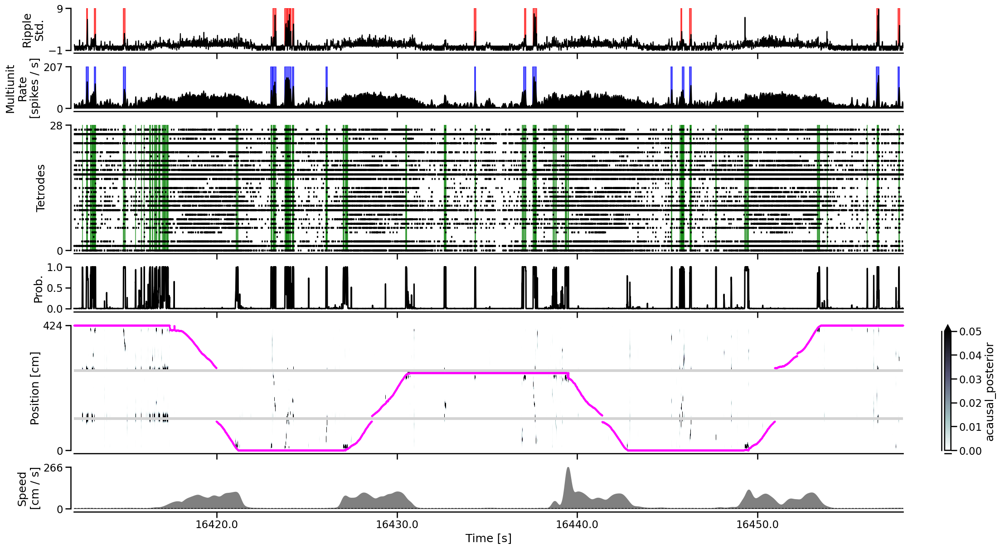

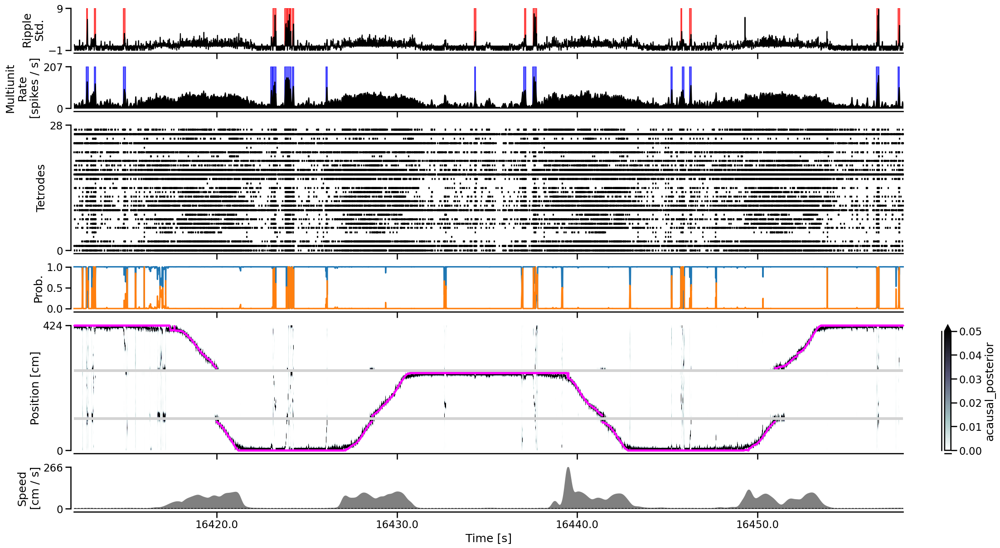

In [10]:
time_slice = slice(22_000, 45_000)
plot_detector(time_slice, data, non_local_detector, non_local_results, figsize=(22, 12.0))
plot_classifier(time_slice, data, classifier, classifier_results, figsize=(22, 12.0))

In [11]:
from replay_identification.multiunit_likelihood_integer_gpu import estimate_non_local_multiunit_likelihood, scale_likelihood

non_local_multiunit_likelihood = estimate_non_local_multiunit_likelihood(
    data['multiunits'].values,
    encoding_marks=non_local_detector._multiunit_likelihood.keywords['encoding_marks'],
    encoding_weights=non_local_detector._multiunit_likelihood.keywords['encoding_weights'],
    mark_std=non_local_detector._multiunit_likelihood.keywords['mark_std'],
    place_bin_centers=non_local_detector._multiunit_likelihood.keywords['place_bin_centers'],
    encoding_positions=non_local_detector._multiunit_likelihood.keywords['encoding_marks_position'],
    position_std=non_local_detector._multiunit_likelihood.keywords['position_std'],
    occupancy=non_local_detector._multiunit_likelihood.keywords['occupancy'],
    mean_rates=non_local_detector._multiunit_likelihood.keywords['mean_rates'],
    summed_ground_process_intensity=non_local_detector._multiunit_likelihood.keywords['summed_ground_process_intensity'],
    max_mark_value=6000,
    is_track_interior=non_local_detector._multiunit_likelihood.keywords['is_track_interior'],
    block_size=non_local_detector._multiunit_likelihood.keywords['block_size'],
    disable_progress_bar=False,
)

n_electrodes:   0%|          | 0/28 [00:00<?, ?it/s]

In [12]:
scaled_non_local_multiunit_likelihood = scale_likelihood(non_local_multiunit_likelihood[:, np.newaxis, :]).squeeze()

In [13]:
from replay_identification.multiunit_likelihood_integer_gpu import estimate_local_multiunit_likelihood

local_multiunit_likelihood = estimate_local_multiunit_likelihood(
    data['multiunits'].values,
    np.asarray(data['position_info'].linear_position)[:, np.newaxis],
    encoding_marks=non_local_detector._multiunit_likelihood.keywords['encoding_marks'],
    encoding_weights=non_local_detector._multiunit_likelihood.keywords['encoding_weights'],
    mark_std=non_local_detector._multiunit_likelihood.keywords['mark_std'],
    encoding_position=non_local_detector._multiunit_likelihood.keywords['encoding_position'],
    encoding_marks_position=non_local_detector._multiunit_likelihood.keywords['encoding_marks_position'],
    position_std=non_local_detector._multiunit_likelihood.keywords['position_std'],
    mean_rates=non_local_detector._multiunit_likelihood.keywords['mean_rates'],
    max_mark_value=6000,
    set_diag_zero=False,
    time_bin_size=1,
    block_size=non_local_detector._multiunit_likelihood.keywords['block_size'],
    is_training=non_local_detector._multiunit_likelihood.keywords['is_training'],
    disable_progress_bar=False,
)

# local_multiunit_likelihood = estimate_local_multiunit_likelihood(
#         non_local_detector._multiunit_likelihood.keywords['place_bin_centers'],
#         non_local_multiunit_likelihood,
#         np.asarray(data['position_info'].linear_position)[:, np.newaxis])


n_electrodes:   0%|          | 0/28 [00:00<?, ?it/s]

In [14]:
local_multiunit_likelihood.shape

(448713,)

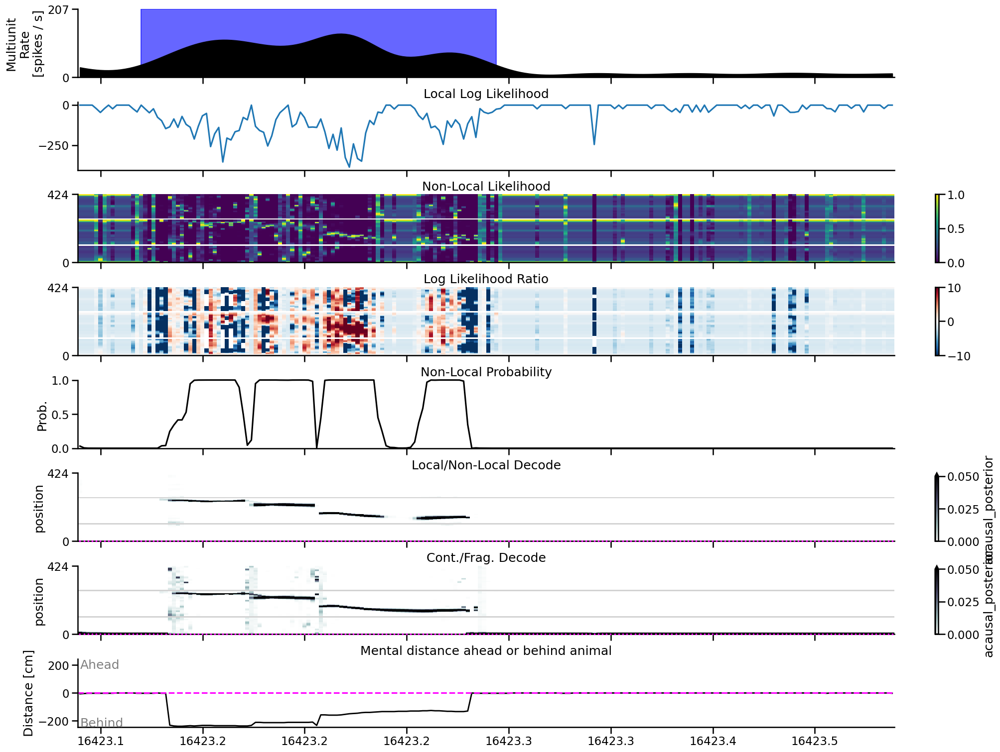

In [15]:
from trajectory_analysis_tools import get_trajectory_data, get_ahead_behind_distance


def plot_detector_diagnostics(
    time_slice,
    non_local_results,
    non_local_multiunit_likelihood,
    scaled_non_local_multiunit_likelihood,
    data,
    classifier,
    classifier_results,
    figsize=(20, 8.0),
):
    
    time = non_local_results.isel(time=time_slice).time.values
    t, p = np.meshgrid(non_local_results.isel(time=time_slice).time.values, non_local_results.position.values)
    max_position = np.ceil(data['position_info'].linear_position.max()).astype(int)

    fig, axes = plt.subplots(8, 1, figsize=figsize, dpi=100, constrained_layout=True, sharex=True, sharey=False)
    
    # axes 0
    multiunit_firing = (
        data["multiunit_firing_rate"]
        .reset_index(drop=True)
        .set_index(
            data["multiunit_firing_rate"].index / np.timedelta64(1, "s"))
    )
    max_multiunit = np.ceil(data["multiunit_firing_rate"].values.max()).astype(int)
    axes[0].fill_between(
        time,
        multiunit_firing.iloc[time_slice].values.squeeze(),
        color="black",
    )
    axes[0].fill_between(
        time, np.ones_like(time) * max_multiunit,
        where=data["multiunit_high_synchrony_labels"].iloc[time_slice].values.squeeze() > 0,
        color='blue', zorder=-2, alpha=0.6, step='pre')
    axes[0].set_ylim((0, max_multiunit))
    axes[0].set_yticks((0, max_multiunit))
    axes[0].set_ylabel("Multiunit\nRate\n[spikes / s]")
    
    # ax 1
    axes[1].plot(time, local_multiunit_likelihood[time_slice])
    axes[1].set_title('Local Log Likelihood')
    axes[1].set_xlabel('')

    # ax 2
    cmap1 = axes[2].pcolormesh(t, p, scaled_non_local_multiunit_likelihood[time_slice].T, vmax=1.0)
    axes[2].set_yticks((0.0, max_position))
    axes[2].set_ylim((0.0, max_position))
    axes[2].set_title('Non-Local Likelihood')

    plt.colorbar(cmap1, ax=axes[2])
    
    # ax 3
    likelihood_ratio = non_local_multiunit_likelihood[time_slice] - local_multiunit_likelihood[time_slice][:, np.newaxis]
    cmap2 = axes[3].pcolormesh(t, p, likelihood_ratio.T,
                               cmap='RdBu_r', vmin=-10, vmax=10)
    axes[3].set_title('Log Likelihood Ratio')
    axes[3].set_yticks((0.0, max_position))
    axes[3].set_ylim((0.0, max_position))
    plt.colorbar(cmap2, ax=axes[3])

    # axes 4
    non_local_results.isel(time=time_slice).non_local_probability.plot(
        x='time', ax=axes[4], color='black', clip_on=False)
    axes[4].set_ylabel('Prob.')
    axes[4].set_xlabel("")
    axes[4].set_ylim((0, 1))
    axes[4].set_title('Non-Local Probability')

    cmap = copy.copy(plt.get_cmap('bone_r'))
    cmap.set_bad(color="lightgrey", alpha=1.0)

    # axes 5
    (non_local_results
     .isel(time=time_slice)
     .acausal_posterior
     .sum('state')
     .where(classifier.environments[0].is_track_interior_)
     .plot(x='time', y='position', ax=axes[5], cmap=cmap,
           vmin=0.0, vmax=0.05))
    axes[5].scatter(time,
                    data['position_info'].iloc[time_slice].linear_position,
                    s=1,
                    color='magenta', clip_on=False, zorder=10)
    axes[5].set_xlabel("")
    axes[5].set_yticks((0.0, max_position))
    axes[5].set_ylim((0.0, max_position))
    axes[5].set_title('Local/Non-Local Decode')
    
    # axes 6
    (classifier_results
     .isel(time=time_slice)
     .acausal_posterior
     .sum('state')
     .where(classifier.environments[0].is_track_interior_)
     .plot(x='time', y='position', ax=axes[6], cmap=cmap,
           vmin=0.0, vmax=0.05))
    axes[6].scatter(time,
                    data['position_info'].iloc[time_slice].linear_position,
                    s=1,
                    color='magenta', clip_on=False, zorder=10)
    axes[6].set_xlabel("")
    axes[6].set_yticks((0.0, max_position))
    axes[6].set_ylim((0.0, max_position))
    axes[6].set_title('Cont./Frag. Decode')


#     trajectory_data = get_trajectory_data(
#         posterior=classifier_results.isel(time=time_slice).sum('state').acausal_posterior,
#         track_graph=data['track_graph'],
#         decoder=classifier,
#         position_info=data['position_info'].iloc[time_slice],
#         direction_variable='body_dir',
#         environment_name=''
#     )
    trajectory_data = get_trajectory_data(
        posterior=classifier_results.isel(time=time_slice).sum('state').acausal_posterior,
        track_graph=data['track_graph'],
        decoder=classifier,
        actual_projected_position=data['position_info'].iloc[time_slice][['projected_x_position', 'projected_y_position']],
        track_segment_id=data['position_info'].iloc[time_slice].track_segment_id,
        actual_orientation=data['position_info'].iloc[time_slice].body_dir,
        environment_name='',
    )
    
    ahead_behind_distance = get_ahead_behind_distance(
        data['track_graph'], *trajectory_data)
    
    axes[7].plot(time,
             ahead_behind_distance,
             color="black", linewidth=2)
    axes[7].axhline(0, color="magenta", linestyle="--")
    axes[7].set_title("Mental distance ahead or behind animal")
    axes[7].set_ylabel("Distance [cm]")
    max_dist = np.max(np.abs(ahead_behind_distance)) + 5
    axes[7].set_ylim((-max_dist, max_dist))
    axes[7].text(time[0], max_dist - 1, "Ahead", color="grey", va='top')
    axes[7].text(time[0], -max_dist + 1, "Behind", color="grey")
    
    axes[-1].xaxis.set_major_formatter(plt.FormatStrFormatter('%.1f'))
    
    sns.despine()
    
    
    
    
time_slice = slice(27_500, 27_700)

plot_detector_diagnostics(
    time_slice,
    non_local_results,
    non_local_multiunit_likelihood,
    scaled_non_local_multiunit_likelihood,
    data,
    classifier,
    classifier_results,
    figsize=(20, 15),
)

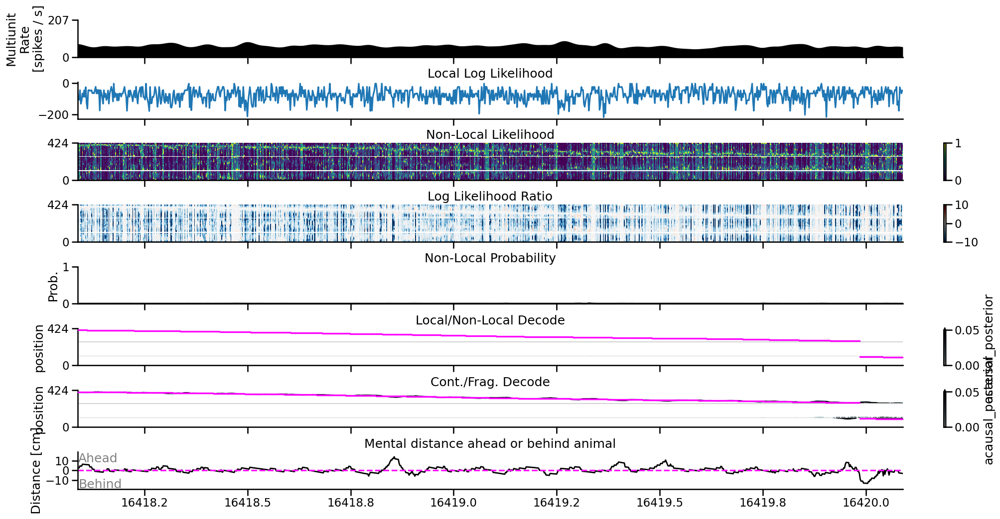

In [16]:
time_slice = slice(25_000, 26_000)

plot_detector_diagnostics(
    time_slice,
    non_local_results,
    non_local_multiunit_likelihood,
    scaled_non_local_multiunit_likelihood,
    data,
    classifier,
    classifier_results,
    figsize=(20, 10),
)

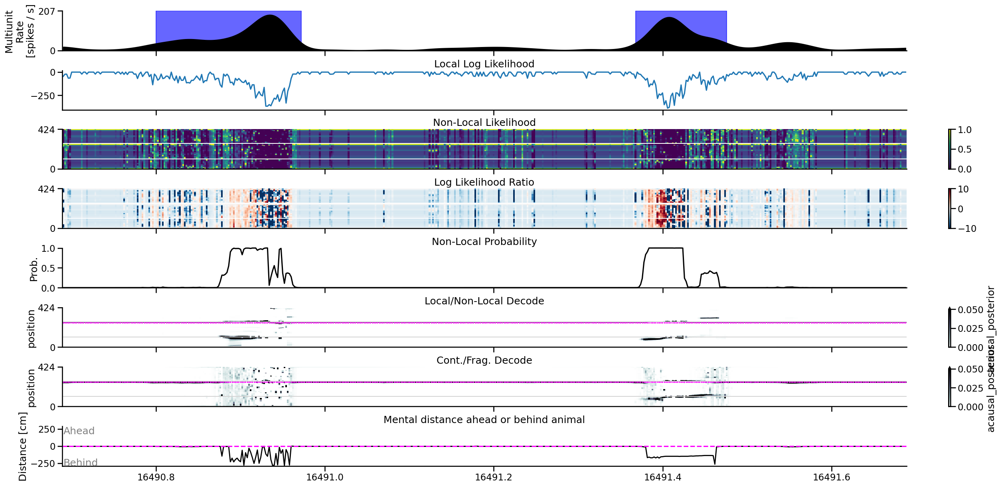

In [17]:
time_slice = slice(61_300, 61_800)

plot_detector_diagnostics(
    time_slice,
    non_local_results,
    non_local_multiunit_likelihood,
    scaled_non_local_multiunit_likelihood,
    data,
    classifier,
    classifier_results,
    figsize=(25, 12),
)

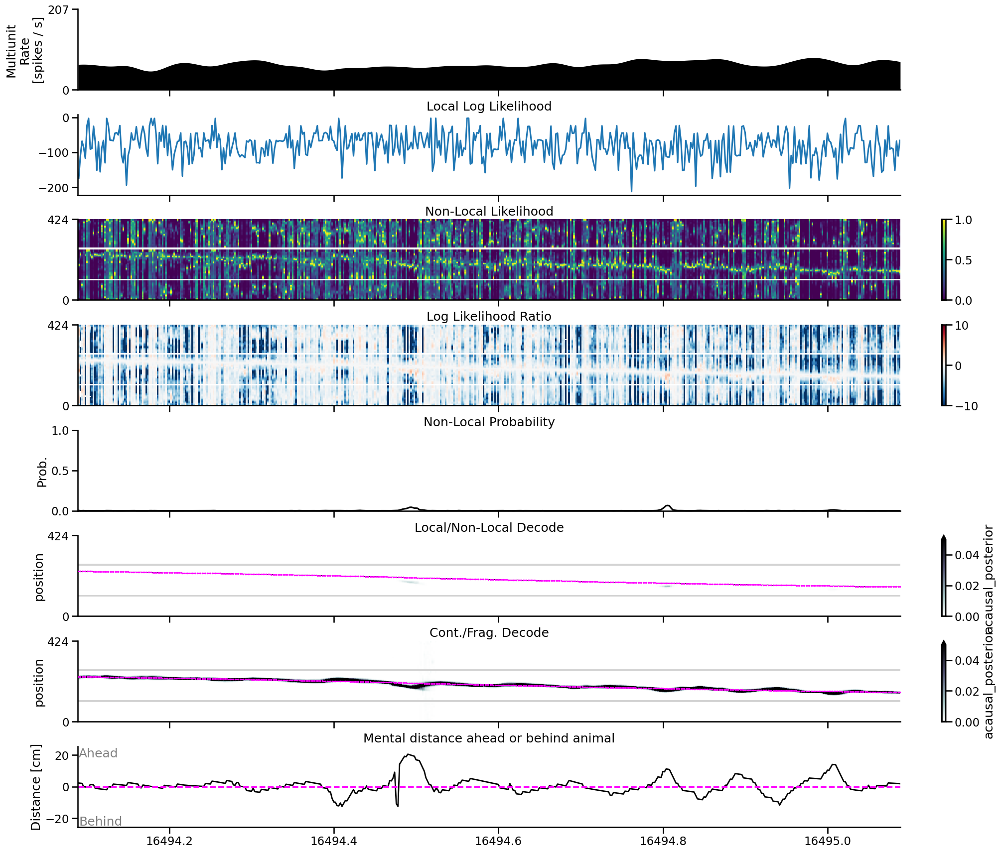

In [18]:
time_slice = slice(63_000, 63_500)

plot_detector_diagnostics(
    time_slice,
    non_local_results,
    non_local_multiunit_likelihood,
    scaled_non_local_multiunit_likelihood,
    data,
    classifier,
    classifier_results,
    figsize=(20, 17),
)

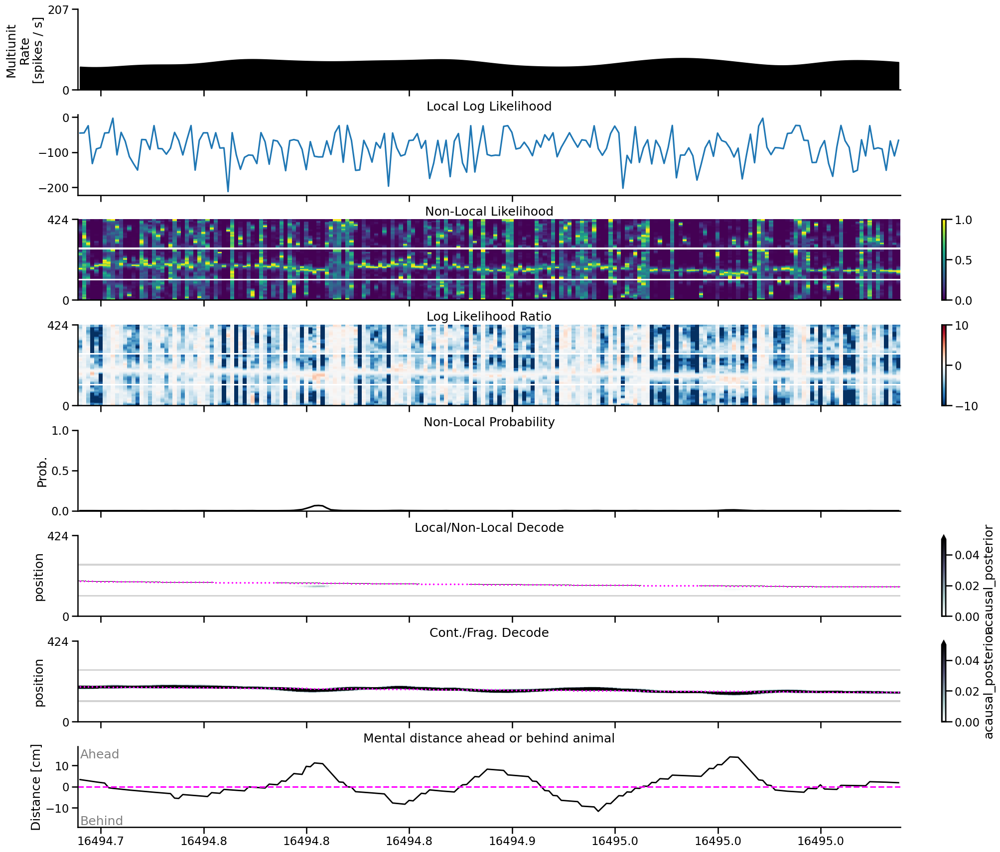

In [19]:
time_slice = slice(63_300, 63_500)

plot_detector_diagnostics(
    time_slice,
    non_local_results,
    non_local_multiunit_likelihood,
    scaled_non_local_multiunit_likelihood,
    data,
    classifier,
    classifier_results,
    figsize=(20, 17),
)

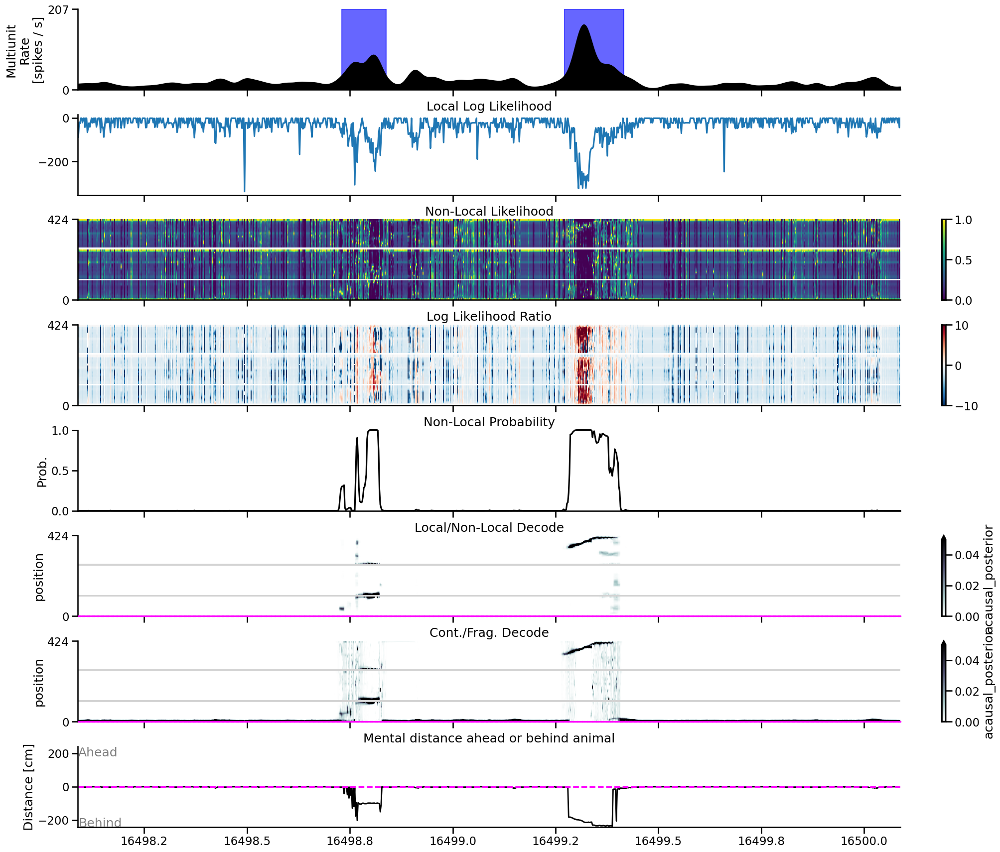

In [20]:
time_slice = slice(65_000, 66_000)

plot_detector_diagnostics(
    time_slice,
    non_local_results,
    non_local_multiunit_likelihood,
    scaled_non_local_multiunit_likelihood,
    data,
    classifier,
    classifier_results,
    figsize=(20, 17),
)

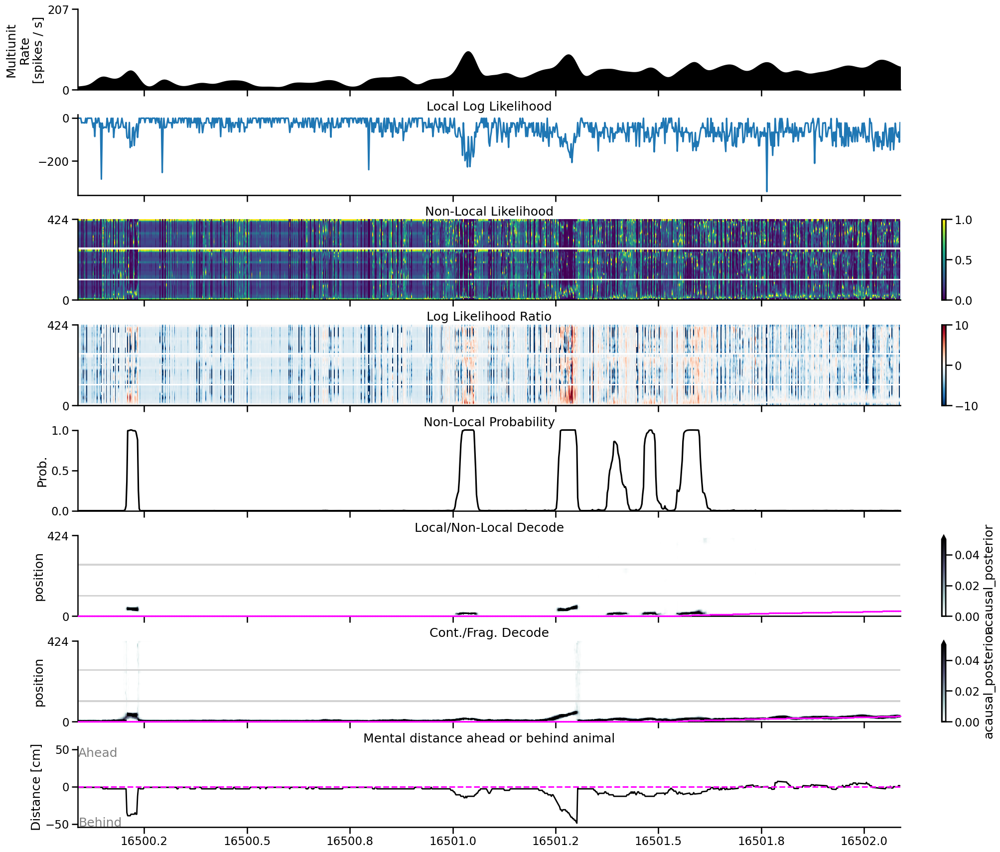

In [21]:
time_slice = slice(66_000, 67_000)

plot_detector_diagnostics(
    time_slice,
    non_local_results,
    non_local_multiunit_likelihood,
    scaled_non_local_multiunit_likelihood,
    data,
    classifier,
    classifier_results,
    figsize=(20, 17),
)

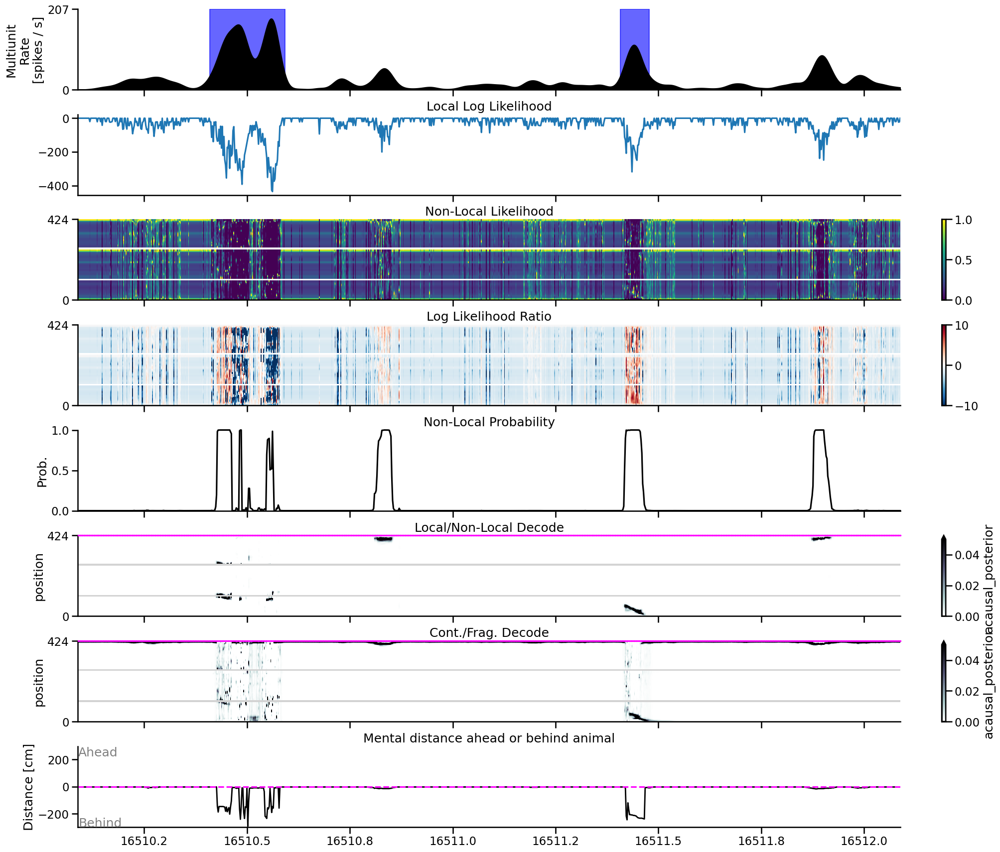

In [22]:
time_slice = slice(71_000, 72_000)

plot_detector_diagnostics(
    time_slice,
    non_local_results,
    non_local_multiunit_likelihood,
    scaled_non_local_multiunit_likelihood,
    data,
    classifier,
    classifier_results,
    figsize=(20, 17),
)

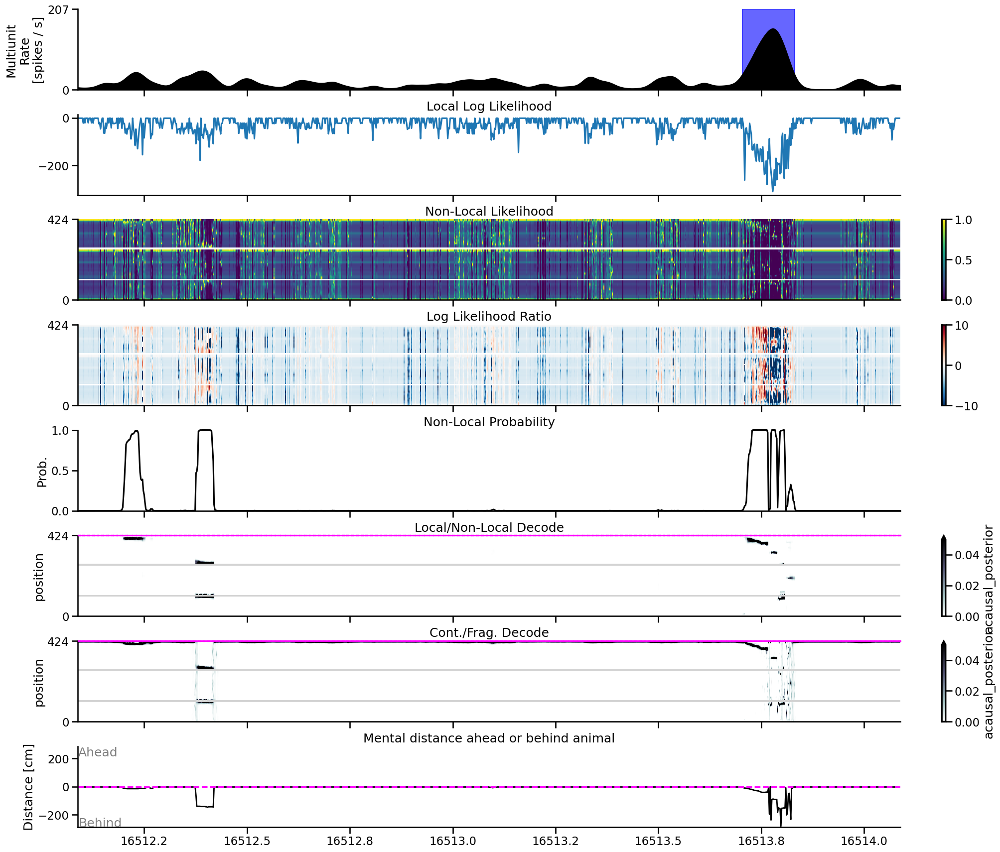

In [23]:
time_slice = slice(72_000, 73_000)

plot_detector_diagnostics(
    time_slice,
    non_local_results,
    non_local_multiunit_likelihood,
    scaled_non_local_multiunit_likelihood,
    data,
    classifier,
    classifier_results,
    figsize=(20, 17),
)

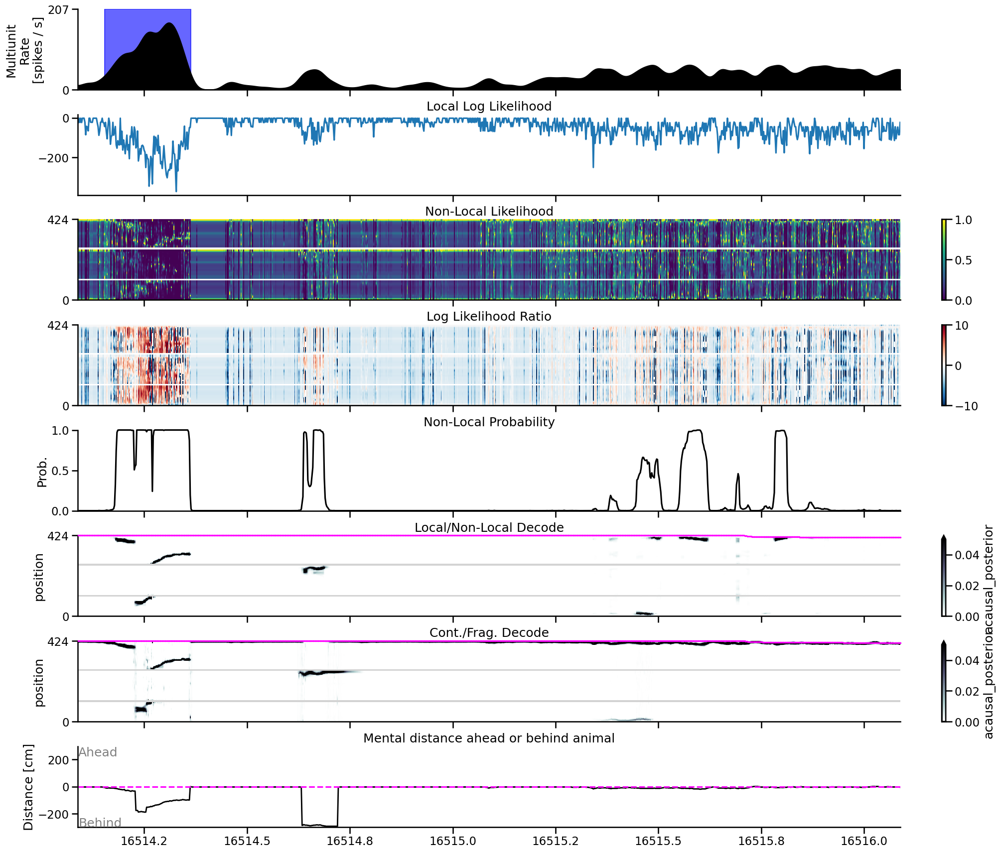

In [24]:
time_slice = slice(73_000, 74_000)

plot_detector_diagnostics(
    time_slice,
    non_local_results,
    non_local_multiunit_likelihood,
    scaled_non_local_multiunit_likelihood,
    data,
    classifier,
    classifier_results,
    figsize=(20, 17),
)

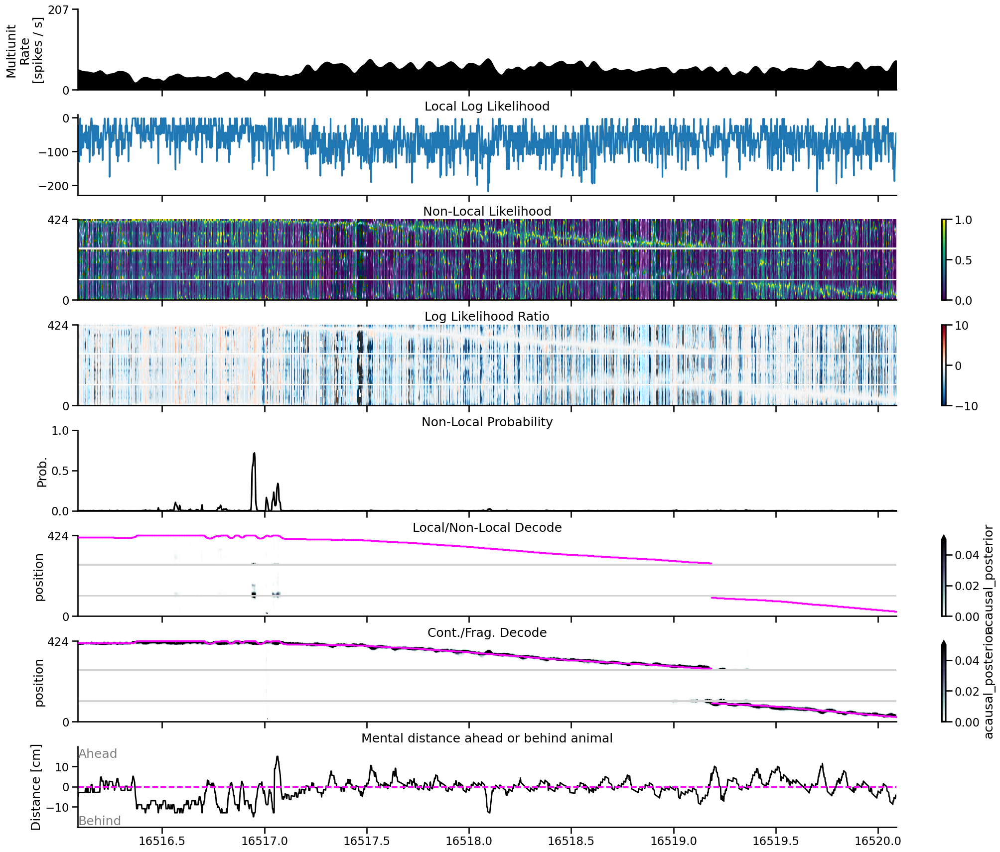

In [25]:
time_slice = slice(74_000, 76_000)

plot_detector_diagnostics(
    time_slice,
    non_local_results,
    non_local_multiunit_likelihood,
    scaled_non_local_multiunit_likelihood,
    data,
    classifier,
    classifier_results,
    figsize=(20, 17),
)

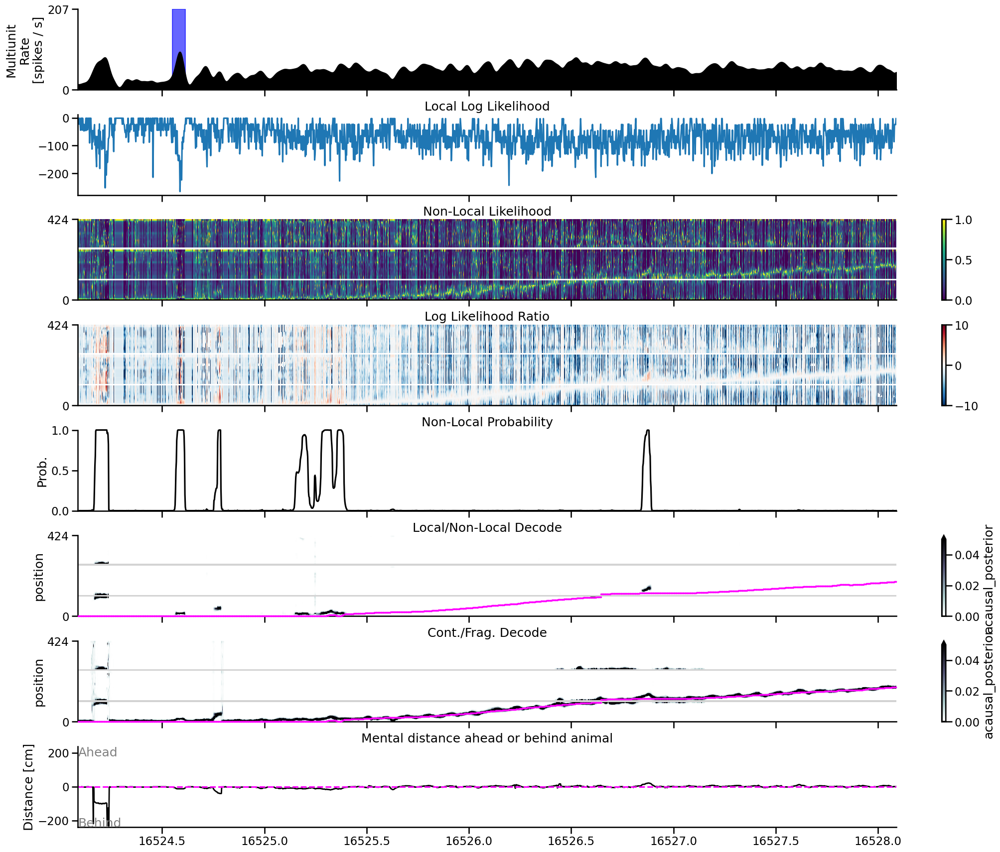

In [26]:
time_slice = slice(78_000, 80_000)

plot_detector_diagnostics(
    time_slice,
    non_local_results,
    non_local_multiunit_likelihood,
    scaled_non_local_multiunit_likelihood,
    data,
    classifier,
    classifier_results,
    figsize=(20, 17),
)

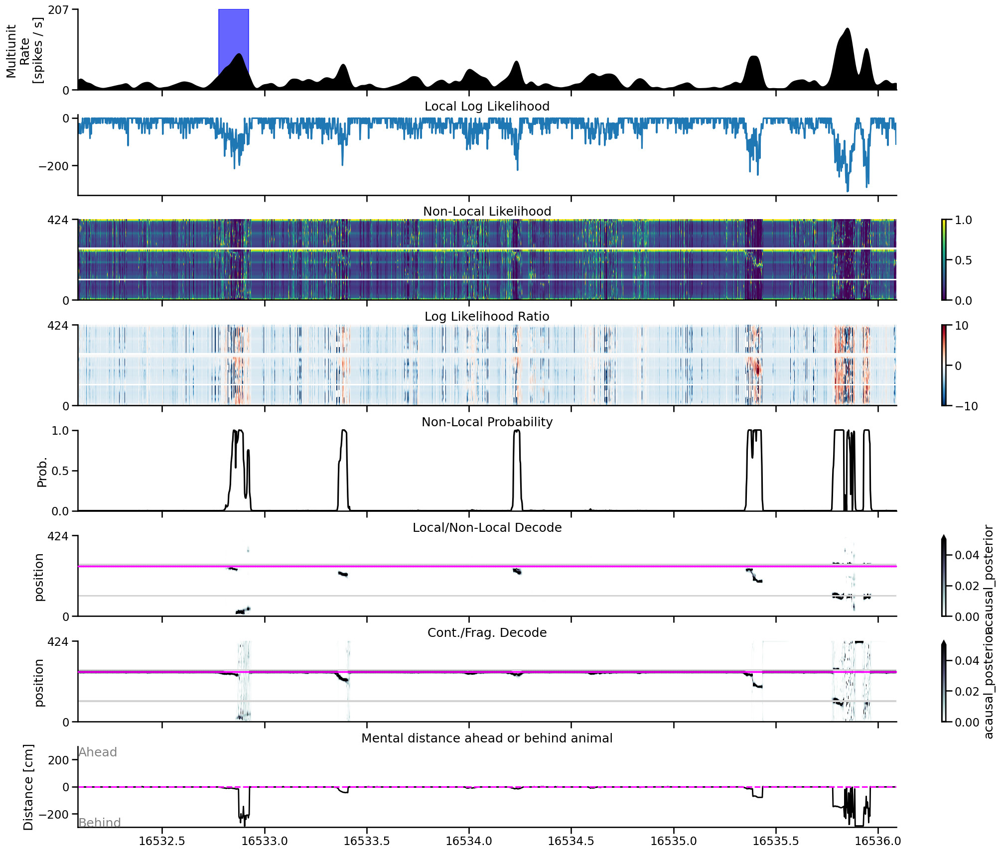

In [27]:
time_slice = slice(82_000, 84_000)

plot_detector_diagnostics(
    time_slice,
    non_local_results,
    non_local_multiunit_likelihood,
    scaled_non_local_multiunit_likelihood,
    data,
    classifier,
    classifier_results,
    figsize=(20, 17),
)

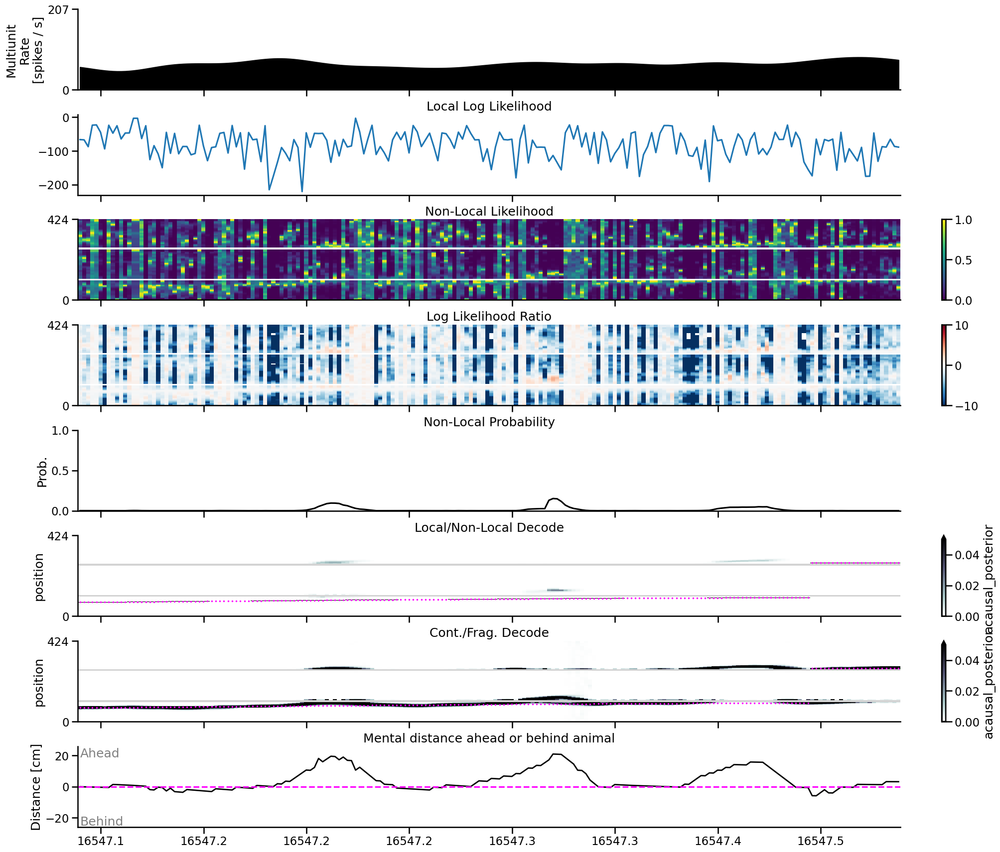

In [28]:
time_slice = slice(89_500, 89_700)

plot_detector_diagnostics(
    time_slice,
    non_local_results,
    non_local_multiunit_likelihood,
    scaled_non_local_multiunit_likelihood,
    data,
    classifier,
    classifier_results,
    figsize=(20, 17),
)

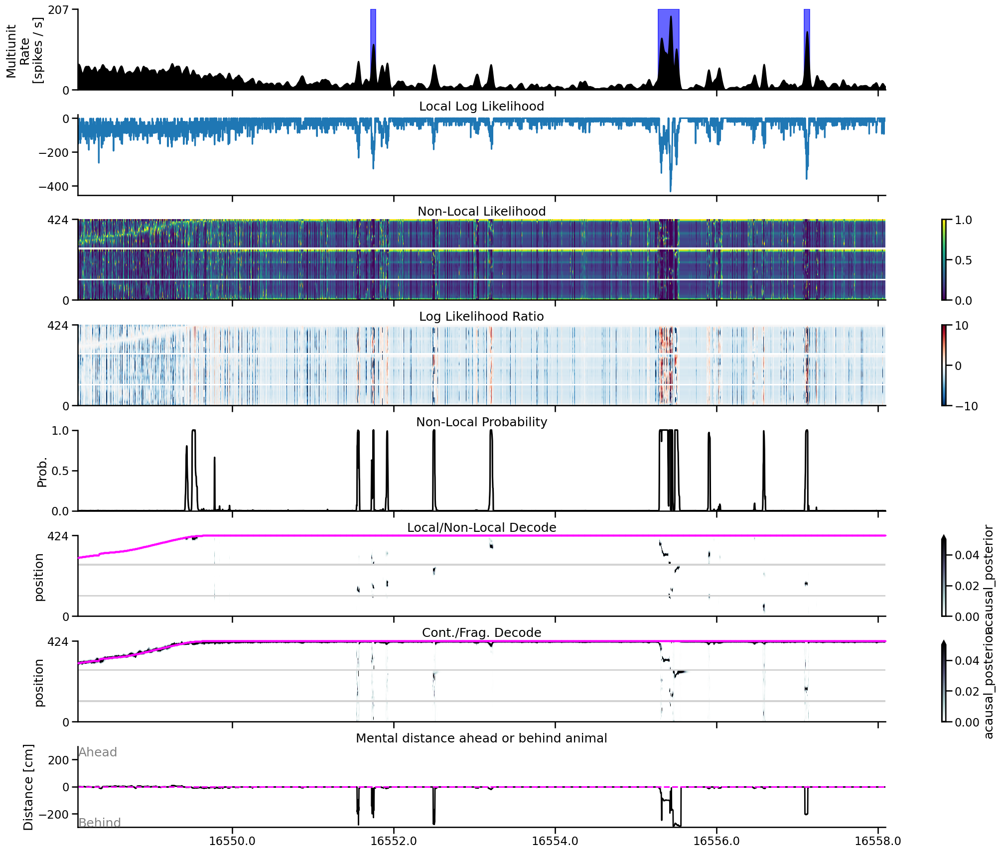

In [29]:
time_slice = slice(90_000, 95_000)

plot_detector_diagnostics(
    time_slice,
    non_local_results,
    non_local_multiunit_likelihood,
    scaled_non_local_multiunit_likelihood,
    data,
    classifier,
    classifier_results,
    figsize=(20, 17),
)

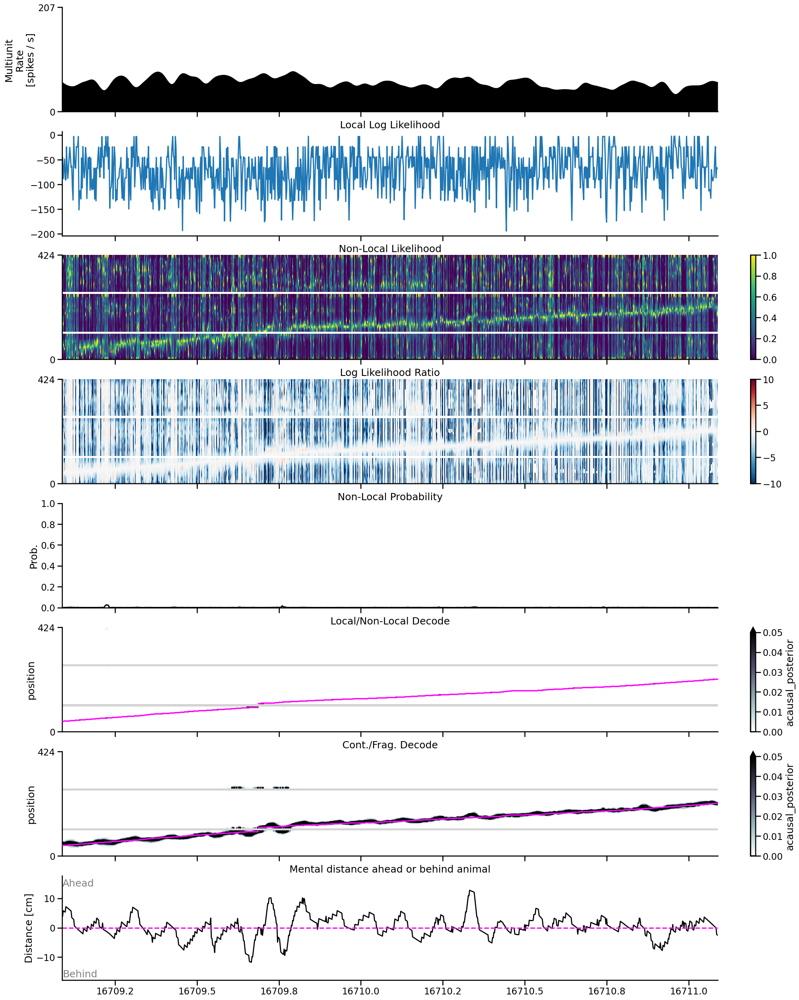

In [30]:
time_slice = slice(170_500, 171_500)

plot_detector_diagnostics(
    time_slice,
    non_local_results,
    non_local_multiunit_likelihood,
    scaled_non_local_multiunit_likelihood,
    data,
    classifier,
    classifier_results,
    figsize=(20, 25),
)

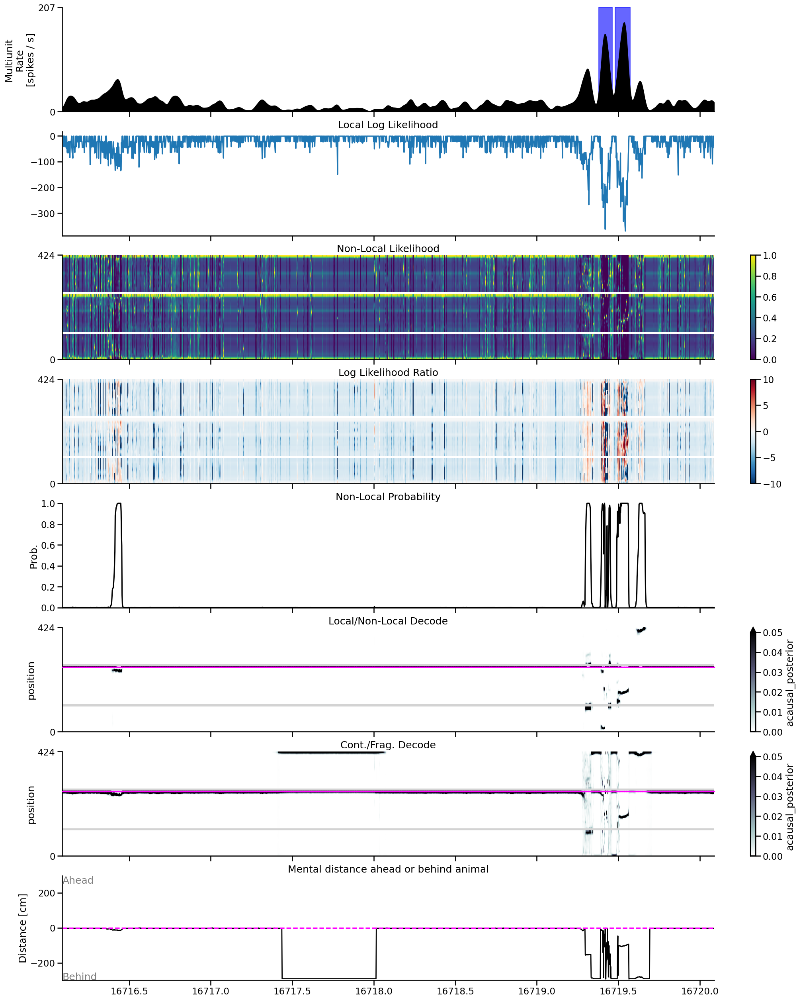

In [31]:
time_slice = slice(174_000, 176_000)

plot_detector_diagnostics(
    time_slice,
    non_local_results,
    non_local_multiunit_likelihood,
    scaled_non_local_multiunit_likelihood,
    data,
    classifier,
    classifier_results,
    figsize=(20, 25),
)

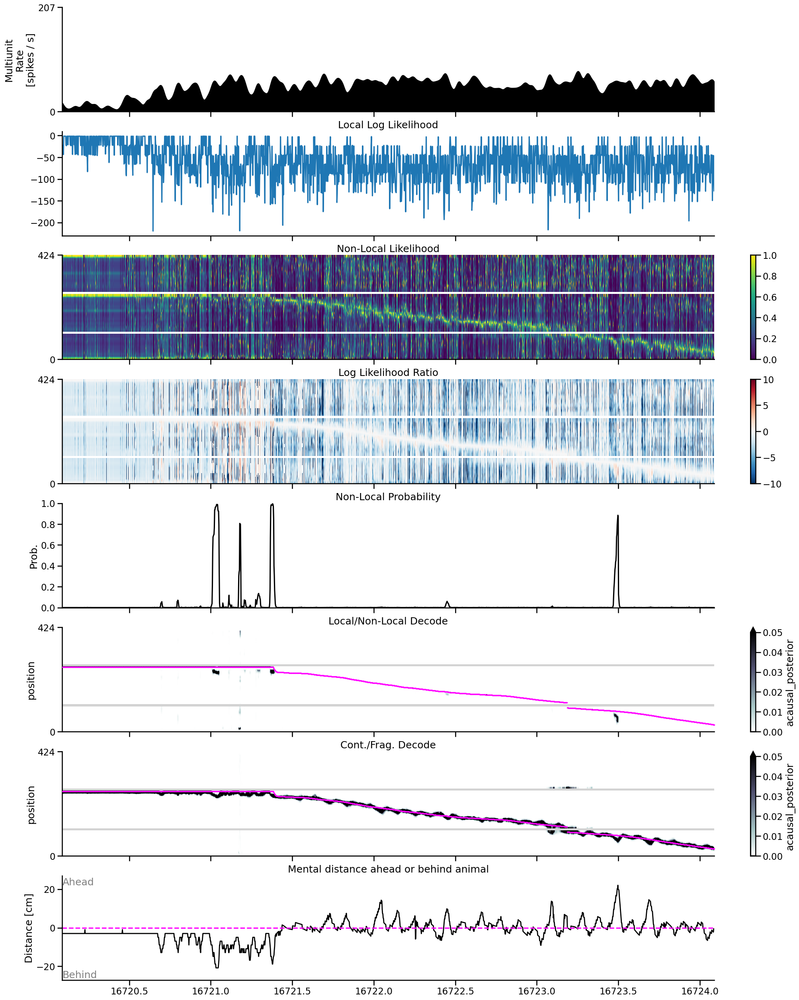

In [32]:
time_slice = slice(176_000, 178_000)

plot_detector_diagnostics(
    time_slice,
    non_local_results,
    non_local_multiunit_likelihood,
    scaled_non_local_multiunit_likelihood,
    data,
    classifier,
    classifier_results,
    figsize=(20, 25),
)

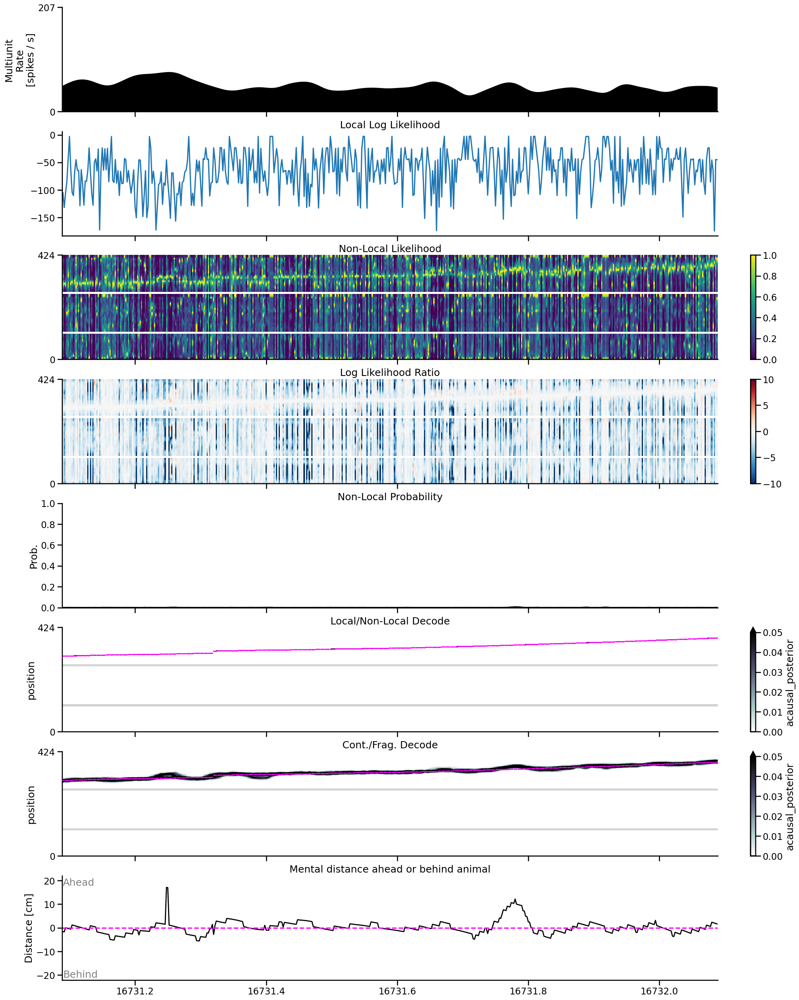

In [33]:
time_slice = slice(181_500, 182_000)

plot_detector_diagnostics(
    time_slice,
    non_local_results,
    non_local_multiunit_likelihood,
    scaled_non_local_multiunit_likelihood,
    data,
    classifier,
    classifier_results,
    figsize=(20, 25),
)

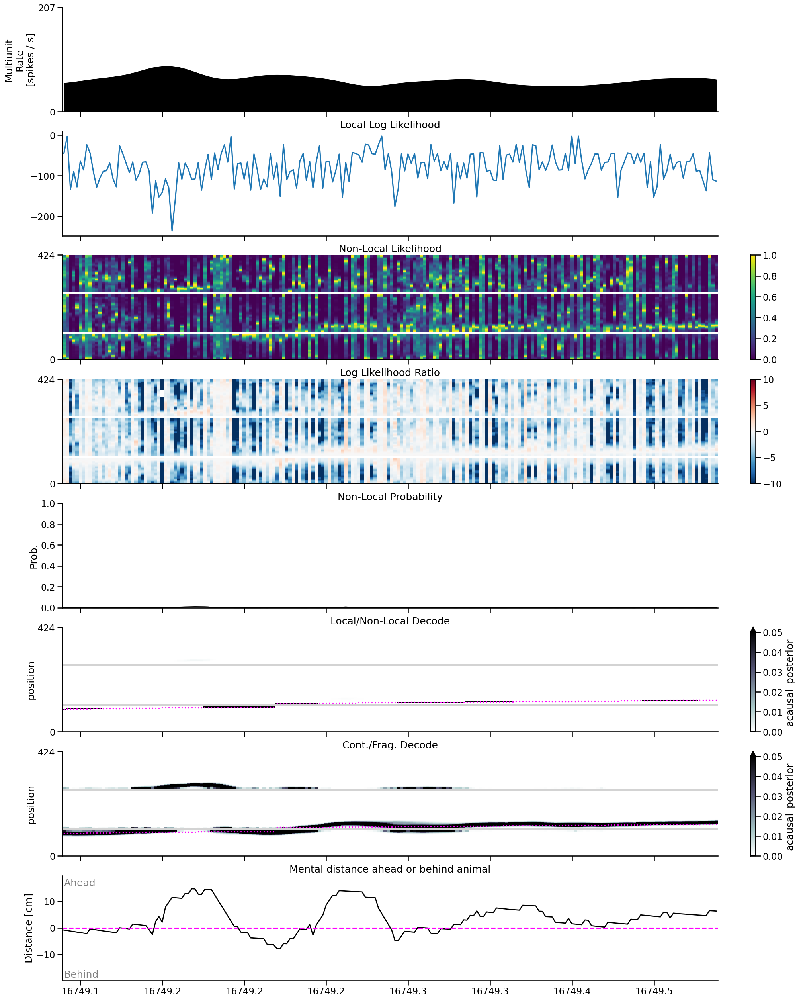

In [34]:
time_slice = slice(190_500, 190_700)

plot_detector_diagnostics(
    time_slice,
    non_local_results,
    non_local_multiunit_likelihood,
    scaled_non_local_multiunit_likelihood,
    data,
    classifier,
    classifier_results,
    figsize=(20, 25),
)

In [35]:
log_likelihood_ratio = non_local_multiunit_likelihood - local_multiunit_likelihood

ValueError: operands could not be broadcast together with shapes (448713,201) (448713,) 

In [ ]:
# local decode should get the same answer at the place bin center points

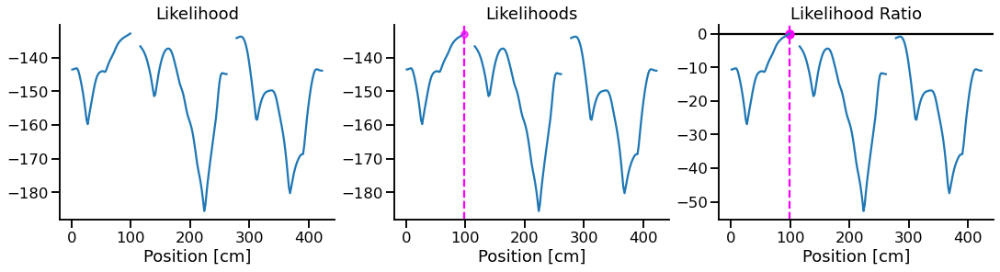

In [36]:
time_ind = 52

fig, axes = plt.subplots(1, 3, constrained_layout=True, figsize=(15, 4), sharex=True)
axes[0].plot(non_local_detector.place_bin_centers_, non_local_multiunit_likelihood[time_slice][time_ind])
axes[0].set_title('Likelihood')
axes[0].set_xlabel('Position [cm]')


axes[1].plot(non_local_detector.place_bin_centers_, non_local_multiunit_likelihood[time_slice][time_ind])
axes[1].scatter(data['position_info'].iloc[time_slice].linear_position[time_ind], local_multiunit_likelihood[time_slice][time_ind],
                color='magenta', s=50, zorder=10, alpha=0.7)
axes[1].axvline(data['position_info'].iloc[time_slice].linear_position[time_ind], color='magenta', zorder=-1, linestyle='--')
axes[1].set_title('Likelihoods')
axes[1].set_xlabel('Position [cm]')

axes[2].scatter(data['position_info'].iloc[time_slice].linear_position[time_ind], 0.0,
            color='magenta')
axes[2].axvline(data['position_info'].iloc[time_slice].linear_position[time_ind], color='magenta', zorder=-1, linestyle='--')

ll_ratio = non_local_multiunit_likelihood[time_slice][time_ind] - local_multiunit_likelihood[time_slice][time_ind]
axes[2].plot(non_local_detector.place_bin_centers_, ll_ratio)
axes[2].axhline(0, color='black', zorder=-2)
axes[2].set_title('Likelihood Ratio')
axes[2].set_xlabel('Position [cm]')
sns.despine()

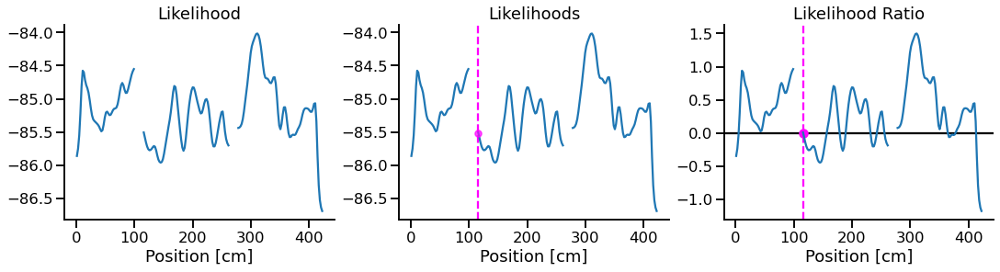

In [37]:
time_ind = 70

fig, axes = plt.subplots(1, 3, constrained_layout=True, figsize=(15, 4), sharex=True)
axes[0].plot(non_local_detector.place_bin_centers_, non_local_multiunit_likelihood[time_slice][time_ind])
axes[0].set_title('Likelihood')
axes[0].set_xlabel('Position [cm]')


axes[1].plot(non_local_detector.place_bin_centers_, non_local_multiunit_likelihood[time_slice][time_ind])
axes[1].scatter(data['position_info'].iloc[time_slice].linear_position[time_ind], local_multiunit_likelihood[time_slice][time_ind],
                color='magenta', s=50, zorder=10, alpha=0.7)
axes[1].axvline(data['position_info'].iloc[time_slice].linear_position[time_ind], color='magenta', zorder=-1, linestyle='--')
axes[1].set_title('Likelihoods')
axes[1].set_xlabel('Position [cm]')

axes[2].scatter(data['position_info'].iloc[time_slice].linear_position[time_ind], 0.0,
            color='magenta')
axes[2].axvline(data['position_info'].iloc[time_slice].linear_position[time_ind], color='magenta', zorder=-1, linestyle='--')

ll_ratio = non_local_multiunit_likelihood[time_slice][time_ind] - local_multiunit_likelihood[time_slice][time_ind]
axes[2].plot(non_local_detector.place_bin_centers_, ll_ratio)
axes[2].axhline(0, color='black', zorder=-2)
axes[2].set_title('Likelihood Ratio')
axes[2].set_xlabel('Position [cm]')
sns.despine()

# TODO #
+ figure out why there are -inf in the likelihood

In [38]:
from src.load_data import get_descending_theta

gnd_lfp, theta_filtered_lfp, is_descending = get_descending_theta(data['tetrode_info'], data['position_info'])

In [39]:
from scipy.signal import hilbert

is_nan = np.isnan(theta_filtered_lfp)
n_samples = theta_filtered_lfp[~is_nan].shape[0]
phase_angle = np.full_like(theta_filtered_lfp, np.nan)
phase_angle[~is_nan] = np.angle(hilbert(theta_filtered_lfp[~is_nan], axis=0))

In [41]:
import pandas as pd

new_index = pd.Index(np.unique(np.concatenate(
    (data['position_info'].index,  data['ripple_consensus_trace'].index))), name='time')
downsampled_phase_angle = (pd.DataFrame(phase_angle).set_index(data['ripple_consensus_trace'].index)
               .reindex(index=new_index)
               .interpolate(method='linear')
               .reindex(index=data['position_info'].index))

downsampled_theta_filtered_lfp = (pd.DataFrame(theta_filtered_lfp).set_index(data['ripple_consensus_trace'].index)
               .reindex(index=new_index)
               .interpolate(method='linear')
               .reindex(index=data['position_info'].index))

In [42]:
trajectory_data = get_trajectory_data(
    posterior=classifier_results.sum('state').acausal_posterior,
    track_graph=data['track_graph'],
    decoder=classifier,
    actual_projected_position=data['position_info'][['projected_x_position', 'projected_y_position']],
    track_segment_id=data['position_info'].track_segment_id,
    actual_orientation=data['position_info'].body_dir,
    environment_name='',
)

ahead_behind_distance = get_ahead_behind_distance(
    data['track_graph'], *trajectory_data)

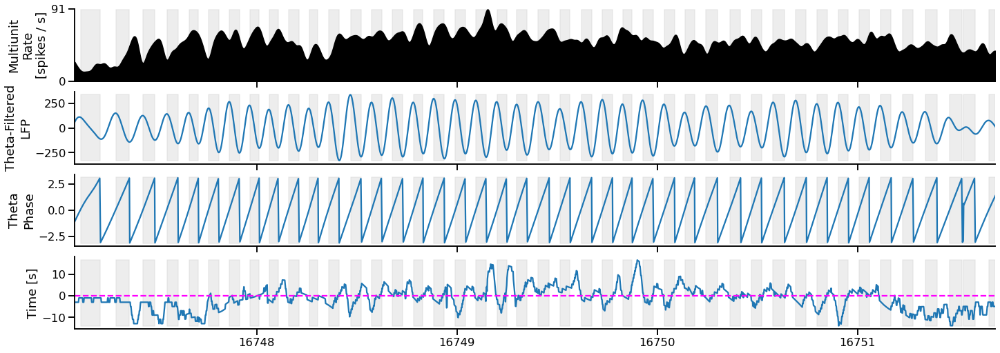

In [51]:
time_slice = slice(189_500, 191_800)

fig, axes = plt.subplots(4, 1, sharex=True, figsize=(20, 7), constrained_layout=True)
# axes 0
multiunit_firing = (
    data["multiunit_firing_rate"]
    .reset_index(drop=True)
    .set_index(
        data["multiunit_firing_rate"].index / np.timedelta64(1, "s"))
)
max_multiunit = np.ceil(data["multiunit_firing_rate"].iloc[time_slice].values.max()).astype(int)
axes[0].fill_between(
    multiunit_firing.iloc[time_slice].index.values,
    multiunit_firing.iloc[time_slice].values.squeeze(),
    color="black",
)
axes[0].set_ylim((0, max_multiunit))
axes[0].set_yticks((0, max_multiunit))
axes[0].fill_between(
    multiunit_firing.iloc[time_slice].index.values,
    multiunit_firing.iloc[time_slice].values.max() * is_descending.values[time_slice],
    color='lightgrey',
    alpha=0.4,
    y2=0.0,
    where=is_descending.values[time_slice],
    zorder=-1
)
axes[0].set_ylabel("Multiunit\nRate\n[spikes / s]")


axes[1].plot(downsampled_theta_filtered_lfp.iloc[time_slice].index / np.timedelta64(1, 's'),
             downsampled_theta_filtered_lfp.iloc[time_slice].values)
axes[1].fill_between(
    data['position_info'].iloc[time_slice].index / np.timedelta64(1, 's'),
    downsampled_theta_filtered_lfp.iloc[time_slice].values.max() * is_descending.values[time_slice],
    color='lightgrey',
    alpha=0.4,
    y2=downsampled_theta_filtered_lfp.iloc[time_slice].values.min(),
    where=is_descending.values[time_slice],
    zorder=-1
)
axes[1].set_ylabel('Theta-Filtered\nLFP')

axes[2].plot(downsampled_theta_filtered_lfp.iloc[time_slice].index / np.timedelta64(1, 's'),
             downsampled_phase_angle.iloc[time_slice].values)
axes[2].fill_between(
    data['position_info'].iloc[time_slice].index / np.timedelta64(1, 's'),
    np.pi * is_descending.values[time_slice],
    color='lightgrey',
    alpha=0.4,
    y2=-np.pi,
    where=is_descending.values[time_slice],
    zorder=-1
)
axes[2].set_ylabel('Theta\nPhase')

axes[3].plot(downsampled_theta_filtered_lfp.iloc[time_slice].index / np.timedelta64(1, 's'),
             ahead_behind_distance[time_slice])
axes[3].axhline(0, color='magenta', linestyle='--')
axes[3].fill_between(
    data['position_info'].iloc[time_slice].index / np.timedelta64(1, 's'),
    ahead_behind_distance[time_slice].max() * is_descending.values[time_slice],
    color='lightgrey',
    alpha=0.4,
    y2=ahead_behind_distance[time_slice].min(),
    where=is_descending.values[time_slice],
    zorder=-1
)
axes[3].set_ylabel('Decode\nDistance [cm]')
axes[3].set_ylabel('Time [s]')

plt.xlim((multiunit_firing.iloc[time_slice].index[0], multiunit_firing.iloc[time_slice].index[-1]))

sns.despine()

(-2.6822424243780327, -0.999321515437547)

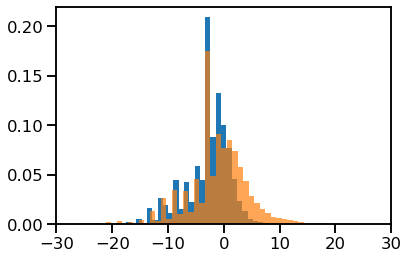

In [54]:
descending_dist = ahead_behind_distance[
    is_descending &
    (data['position_info'].nose_vel.values > 4)
]
ascending_dist = ahead_behind_distance[
    (~is_descending) &
    (data['position_info'].nose_vel.values > 4)
]

plt.hist(descending_dist, bins=500, density=True);
plt.hist(ascending_dist, bins=500, alpha=0.7, density=True);
plt.xlim((-30, 30))

np.median(descending_dist), np.median(ascending_dist) 

<AxesSubplot:xlabel='phase_angle'>

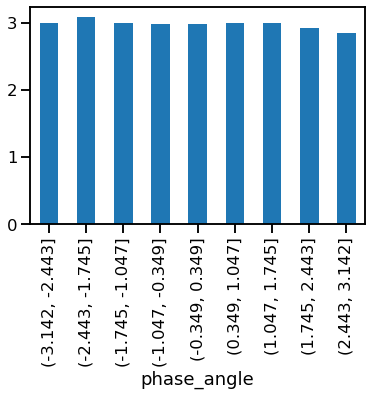

In [55]:
pd.DataFrame(
    np.stack([np.abs(ahead_behind_distance[(data['position_info'].nose_vel.values > 4)]),
              pd.cut(downsampled_phase_angle[(data['position_info'].nose_vel.values > 4)].squeeze(),
                     bins=np.pi * np.linspace(-1, 1, 10))], axis=1),
    columns=['ahead_behind_distance', 'phase_angle']
).groupby('phase_angle').median().plot(kind='bar', legend=False)

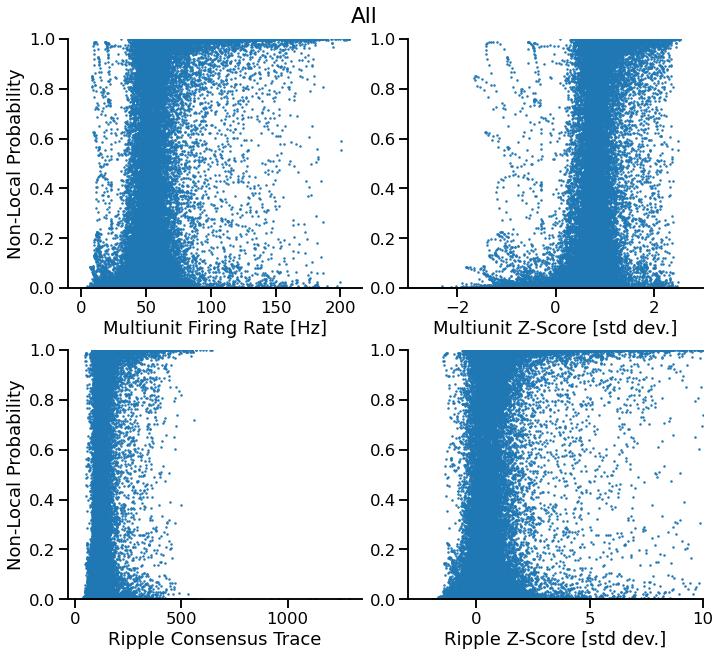

In [56]:
import seaborn as sns
import pandas as pd

fig, axes = plt.subplots(2, 2, constrained_layout=True, figsize=(10, 9))
axes[0, 0].scatter(data['multiunit_firing_rate'], non_local_results.non_local_probability, s=1)

axes[0, 0].set_xlabel('Multiunit Firing Rate [Hz]')
axes[0, 0].set_ylabel('Non-Local Probability')
axes[0, 0].set_ylim((0, 1))

axes[0, 1].scatter(data['multiunit_rate_zscore'], non_local_results.non_local_probability, s=1)

axes[0, 1].set_xlim((-3, 3))
axes[0, 1].set_xlabel('Multiunit Z-Score [std dev.]')
axes[0, 1].set_ylim((0, 1))


new_index = pd.Index(np.unique(np.concatenate(
    (data['position_info'].index,  data['ripple_consensus_trace'].index))), name='time')
ripple_consensus_trace = (data['ripple_consensus_trace']
               .reindex(index=new_index)
               .interpolate(method='linear')
               .reindex(index=data['position_info'].index))
new_index = pd.Index(np.unique(np.concatenate(
    (data['position_info'].index,  data['ripple_consensus_trace_zscore'].index))), name='time')
ripple_consensus_trace_zscore = (data['ripple_consensus_trace_zscore']
               .reindex(index=new_index)
               .interpolate(method='linear')
               .reindex(index=data['position_info'].index))


axes[1, 0].scatter(ripple_consensus_trace, non_local_results.non_local_probability, s=1)

axes[1, 0].set_xlabel('Ripple Consensus Trace')
axes[1, 0].set_ylabel('Non-Local Probability')
axes[1, 0].set_ylim((0, 1))

axes[1, 1].scatter(ripple_consensus_trace_zscore, non_local_results.non_local_probability, s=1)

axes[1, 1].set_xlim((-3, 10))
axes[1, 1].set_xlabel('Ripple Z-Score [std dev.]')
axes[1, 1].set_ylim((0, 1))
plt.suptitle('All')

sns.despine()

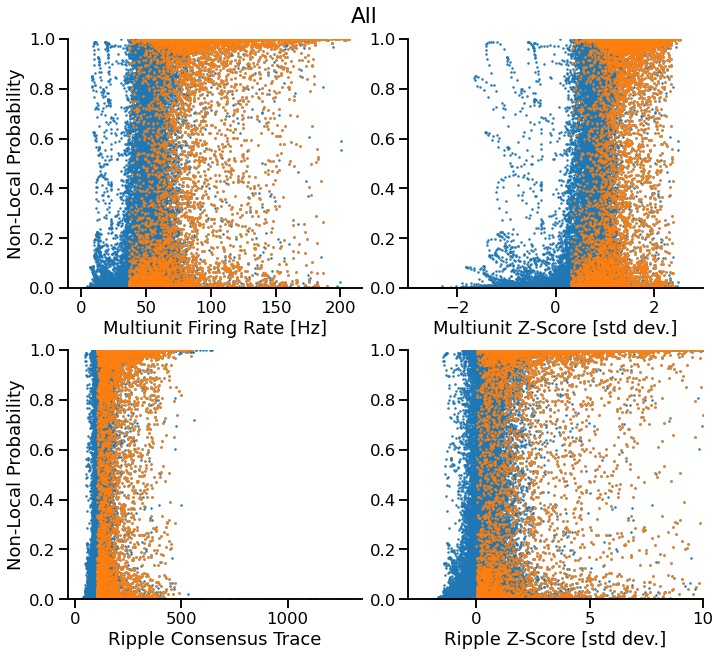

In [57]:
import seaborn as sns

fig, axes = plt.subplots(2, 2, constrained_layout=True, figsize=(10, 9))
axes[0, 0].scatter(data['multiunit_firing_rate'], non_local_results.non_local_probability, s=1)
axes[0, 0].scatter(data['multiunit_firing_rate'].loc[data['is_multiunit_high_synchrony'].squeeze()],
                   non_local_results.non_local_probability.values[data['is_multiunit_high_synchrony'].values.squeeze()], s=1)

axes[0, 0].set_xlabel('Multiunit Firing Rate [Hz]')
axes[0, 0].set_ylabel('Non-Local Probability')
axes[0, 0].set_ylim((0, 1))

axes[0, 1].scatter(data['multiunit_rate_zscore'], non_local_results.non_local_probability, s=1)
axes[0, 1].scatter(data['multiunit_rate_zscore'].loc[data['is_multiunit_high_synchrony'].squeeze()],
                   non_local_results.non_local_probability.values[data['is_multiunit_high_synchrony'].values.squeeze()], s=1)

axes[0, 1].set_xlim((-3, 3))
axes[0, 1].set_xlabel('Multiunit Z-Score [std dev.]')
axes[0, 1].set_ylim((0, 1))


new_index = pd.Index(np.unique(np.concatenate(
    (data['position_info'].index,  data['ripple_consensus_trace'].index))), name='time')
ripple_consensus_trace = (data['ripple_consensus_trace']
               .reindex(index=new_index)
               .interpolate(method='linear')
               .reindex(index=data['position_info'].index))
new_index = pd.Index(np.unique(np.concatenate(
    (data['position_info'].index,  data['ripple_consensus_trace_zscore'].index))), name='time')
ripple_consensus_trace_zscore = (data['ripple_consensus_trace_zscore']
               .reindex(index=new_index)
               .interpolate(method='linear')
               .reindex(index=data['position_info'].index))


axes[1, 0].scatter(ripple_consensus_trace, non_local_results.non_local_probability, s=1)
axes[1, 0].scatter(ripple_consensus_trace.loc[data['is_ripple'].squeeze()],
                   non_local_results.non_local_probability.values[data['is_ripple'].values.squeeze()], s=1)

axes[1, 0].set_xlabel('Ripple Consensus Trace')
axes[1, 0].set_ylabel('Non-Local Probability')
axes[1, 0].set_ylim((0, 1))

axes[1, 1].scatter(ripple_consensus_trace_zscore, non_local_results.non_local_probability, s=1)
axes[1, 1].scatter(ripple_consensus_trace_zscore.loc[data['is_ripple'].squeeze()],
                   non_local_results.non_local_probability.values[data['is_ripple'].values.squeeze()], s=1)

axes[1, 1].set_xlim((-3, 10))
axes[1, 1].set_xlabel('Ripple Z-Score [std dev.]')
axes[1, 1].set_ylim((0, 1))
plt.suptitle('All')

sns.despine()

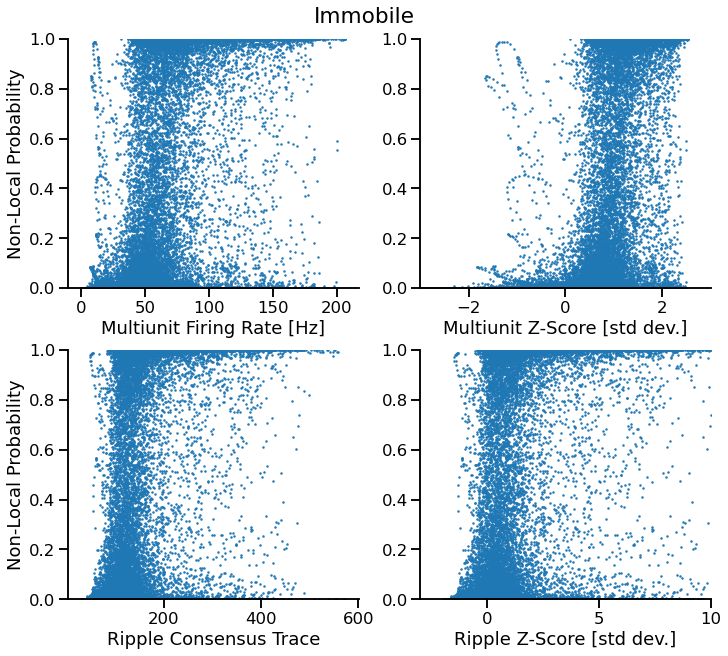

In [58]:
import seaborn as sns
import pandas as pd

fig, axes = plt.subplots(2, 2, constrained_layout=True, figsize=(10, 9))
axes[0, 0].scatter(data['multiunit_firing_rate'].values[data['position_info'].nose_vel < 4],
                   non_local_results.non_local_probability.values[data['position_info'].nose_vel < 4], s=1)

axes[0, 0].set_xlabel('Multiunit Firing Rate [Hz]')
axes[0, 0].set_ylabel('Non-Local Probability')
axes[0, 0].set_ylim((0, 1))

axes[0, 1].scatter(data['multiunit_rate_zscore'].values[data['position_info'].nose_vel < 4],
                   non_local_results.non_local_probability.values[data['position_info'].nose_vel < 4], s=1)

axes[0, 1].set_xlim((-3, 3))
axes[0, 1].set_xlabel('Multiunit Z-Score [std dev.]')
axes[0, 1].set_ylim((0, 1))


new_index = pd.Index(np.unique(np.concatenate(
    (data['position_info'].index,  data['ripple_consensus_trace'].index))), name='time')
ripple_consensus_trace = (data['ripple_consensus_trace']
               .reindex(index=new_index)
               .interpolate(method='linear')
               .reindex(index=data['position_info'].index))
new_index = pd.Index(np.unique(np.concatenate(
    (data['position_info'].index,  data['ripple_consensus_trace_zscore'].index))), name='time')
ripple_consensus_trace_zscore = (data['ripple_consensus_trace_zscore']
               .reindex(index=new_index)
               .interpolate(method='linear')
               .reindex(index=data['position_info'].index))


axes[1, 0].scatter(ripple_consensus_trace.values[data['position_info'].nose_vel < 4],
                   non_local_results.non_local_probability.values[data['position_info'].nose_vel < 4], s=1)

axes[1, 0].set_xlabel('Ripple Consensus Trace')
axes[1, 0].set_ylabel('Non-Local Probability')
axes[1, 0].set_ylim((0, 1))

axes[1, 1].scatter(ripple_consensus_trace_zscore.values[data['position_info'].nose_vel < 4],
                   non_local_results.non_local_probability.values[data['position_info'].nose_vel < 4], s=1)

axes[1, 1].set_xlim((-3, 10))
axes[1, 1].set_xlabel('Ripple Z-Score [std dev.]')
axes[1, 1].set_ylim((0, 1))

plt.suptitle('Immobile')
sns.despine()

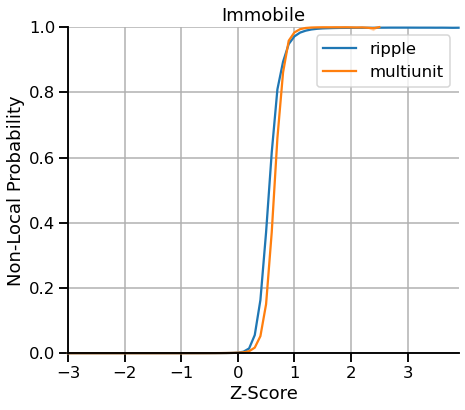

In [70]:
def std_dev_prob(x):
    return np.sqrt(np.asarray(x) * (1 - np.asarray(x)))

thresh_values = np.arange(-3, 4, 0.1)
is_immobile = data['position_info'].nose_vel.squeeze() <= 4

prob_non_local_by_thresh_ripple = [
    np.median(non_local_results.non_local_probability.values[is_immobile][ripple_consensus_trace_zscore.values.squeeze()[is_immobile] > thresh])
     for thresh in thresh_values]
n_samples_by_thresh_ripple = [
    (ripple_consensus_trace_zscore.values.squeeze()[is_immobile] > thresh).sum()
     for thresh in thresh_values]

prob_non_local_by_thresh_multiunit = [
    np.median(non_local_results.non_local_probability.values[is_immobile][data['multiunit_rate_zscore'].values.squeeze()[is_immobile] > thresh])
     for thresh in thresh_values]
n_samples_by_thresh_multiunit = [
    (data['multiunit_rate_zscore'].values.squeeze()[is_immobile] > thresh).sum()
     for thresh in thresh_values]

plt.figure(figsize=(7, 6))
plt.fill_between(thresh_values, prob_non_local_by_thresh_ripple - (std_dev_prob(prob_non_local_by_thresh_ripple) / np.sqrt(n_samples_by_thresh_ripple)),
                 prob_non_local_by_thresh_ripple + 1.96 * (std_dev_prob(prob_non_local_by_thresh_ripple)  / np.sqrt(n_samples_by_thresh_ripple)), alpha=0.3)
plt.plot(thresh_values, prob_non_local_by_thresh_ripple, label='ripple', clip_on=False)

plt.fill_between(thresh_values, prob_non_local_by_thresh_multiunit - (std_dev_prob(prob_non_local_by_thresh_multiunit) / np.sqrt(n_samples_by_thresh_multiunit)),
                 prob_non_local_by_thresh_multiunit + 1.96 * (std_dev_prob(prob_non_local_by_thresh_multiunit)  / np.sqrt(n_samples_by_thresh_multiunit)), alpha=0.3)
plt.plot(thresh_values, prob_non_local_by_thresh_multiunit, label='multiunit', clip_on=False)
plt.xticks(np.arange(thresh_values.min(), thresh_values.max()));
plt.title('Immobile')
plt.grid('on')
plt.legend()
plt.xlim((thresh_values.min(), thresh_values.max()))
plt.ylabel('Non-Local Probability')
plt.xlabel('Z-Score')
plt.ylim((0, 1))
sns.despine()

In [65]:
np.median(non_local_results.non_local_probability.values[is_immobile][ripple_consensus_trace_zscore.values.squeeze()[is_immobile] > 2])

0.9978344421001575

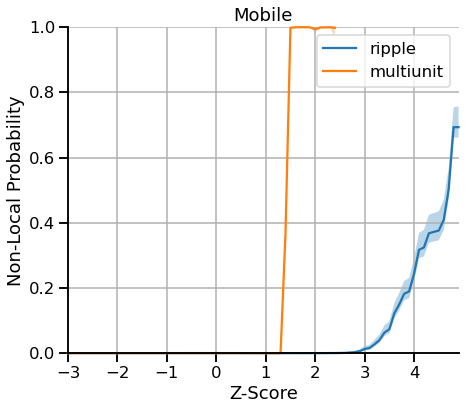

In [74]:
def std_dev_prob(x):
    return np.sqrt(np.asarray(x) * (1 - np.asarray(x)))

thresh_values = np.arange(-3, 5, 0.1)
is_mobile = data['position_info'].nose_vel.squeeze() > 4

prob_non_local_by_thresh_ripple = [
    np.median(non_local_results.non_local_probability.values[is_mobile][ripple_consensus_trace_zscore.values.squeeze()[is_mobile] > thresh])
     for thresh in thresh_values]
n_samples_by_thresh_ripple = [
    (ripple_consensus_trace_zscore.values.squeeze()[is_mobile] > thresh).sum()
     for thresh in thresh_values]

prob_non_local_by_thresh_multiunit = [
    np.median(non_local_results.non_local_probability.values[is_mobile][data['multiunit_rate_zscore'].values.squeeze()[is_mobile] > thresh])
     for thresh in thresh_values]
n_samples_by_thresh_multiunit = [
    (data['multiunit_rate_zscore'].values.squeeze()[is_mobile] > thresh).sum()
     for thresh in thresh_values]

plt.figure(figsize=(7, 6))
plt.fill_between(thresh_values, prob_non_local_by_thresh_ripple - (std_dev_prob(prob_non_local_by_thresh_ripple) / np.sqrt(n_samples_by_thresh_ripple)),
                 prob_non_local_by_thresh_ripple + 1.96 * (std_dev_prob(prob_non_local_by_thresh_ripple)  / np.sqrt(n_samples_by_thresh_ripple)), alpha=0.3)
plt.plot(thresh_values, prob_non_local_by_thresh_ripple, label='ripple', clip_on=False)

plt.fill_between(thresh_values, prob_non_local_by_thresh_multiunit - (std_dev_prob(prob_non_local_by_thresh_multiunit) / np.sqrt(n_samples_by_thresh_multiunit)),
                 prob_non_local_by_thresh_multiunit + 1.96 * (std_dev_prob(prob_non_local_by_thresh_multiunit)  / np.sqrt(n_samples_by_thresh_multiunit)), alpha=0.3)
plt.plot(thresh_values, prob_non_local_by_thresh_multiunit, label='multiunit', clip_on=False)
plt.xticks(np.arange(thresh_values.min(), thresh_values.max()));
plt.title('Mobile')
plt.grid('on')
plt.legend()
plt.xlim((thresh_values.min(), thresh_values.max()))
plt.ylabel('Non-Local Probability')
plt.xlabel('Z-Score')
plt.ylim((0, 1))
sns.despine()

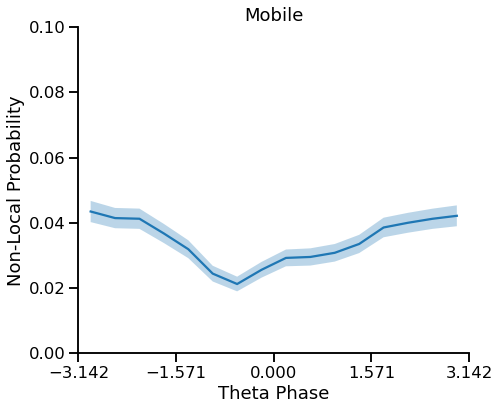

In [77]:
new_index = pd.Index(np.unique(np.concatenate(
    (data['position_info'].index,  data['ripple_consensus_trace'].index))), name='time')
downsampled_phase_angle = (pd.DataFrame(phase_angle).set_index(data['ripple_consensus_trace'].index)
               .reindex(index=new_index)
               .interpolate(method='linear')
               .reindex(index=data['position_info'].index))

angle_range = np.arange(-np.pi, np.pi + np.pi/8, np.pi/8)
avg_non_local_by_angle = []
n_in_angle_range = []
for start_angle, stop_angle in zip(angle_range[:-1], angle_range[1:]):
    is_in_angle_range = (downsampled_phase_angle.values >= start_angle) & (downsampled_phase_angle.values < stop_angle)
    is_in_angle_range = is_in_angle_range.squeeze() & (data['position_info'].nose_vel.values.squeeze() > 4)
    n_in_angle_range.append(is_in_angle_range.sum())
    avg_non_local_by_angle.append(non_local_results.non_local_probability.values[is_in_angle_range].mean())
    
plt.figure(figsize=(7, 6))
plt.fill_between(angle_range[:-1] + np.diff(angle_range) / 2,
                 avg_non_local_by_angle - 1.96 * (std_dev_prob(avg_non_local_by_angle) / np.sqrt(n_in_angle_range)),
                 avg_non_local_by_angle + 1.96 * (std_dev_prob(avg_non_local_by_angle) / np.sqrt(n_in_angle_range)),
                 alpha=0.3
                )
plt.plot(angle_range[:-1] + np.diff(angle_range) / 2, avg_non_local_by_angle)
plt.xticks(np.arange(-np.pi, np.pi + np.pi/2, np.pi/2));
plt.xlim((-np.pi, np.pi))
plt.ylim((0.0, 0.1))
plt.xlabel('Theta Phase')
plt.ylabel('Non-Local Probability')
plt.title('Mobile')
sns.despine()

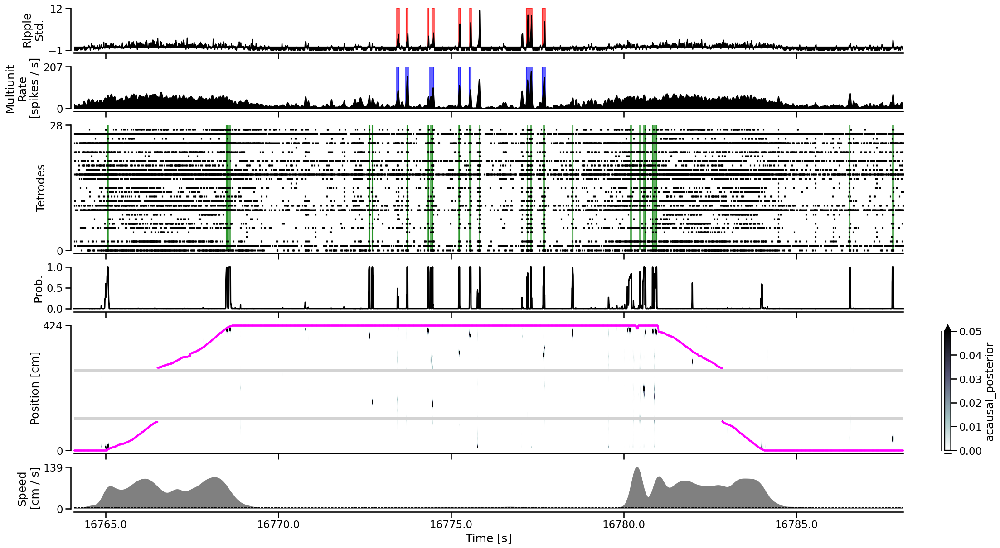

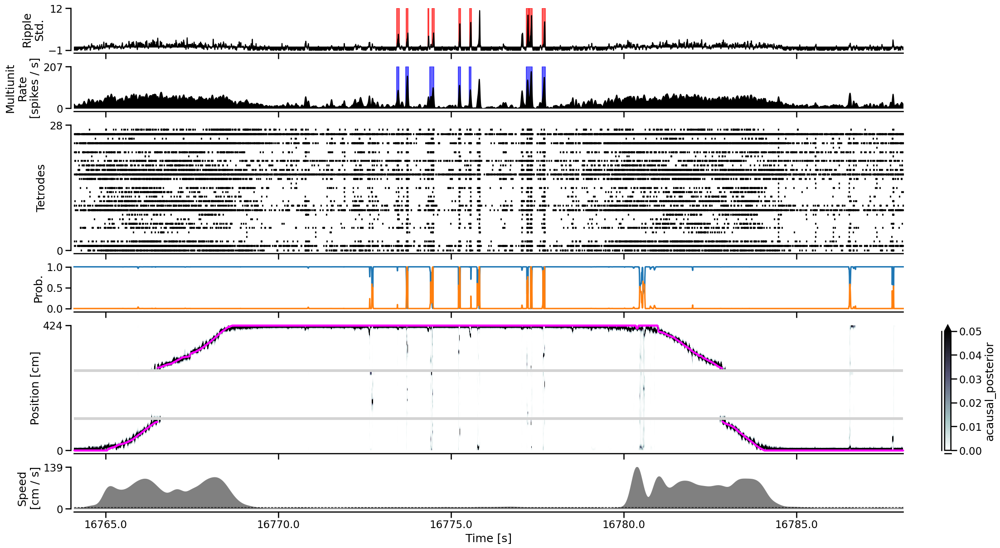

In [227]:
time_slice = slice(198_000, 210_000)
plot_detector(time_slice, data, non_local_detector, non_local_results, figsize=(22, 12.0))
plot_classifier(time_slice, data, classifier, classifier_results, figsize=(22, 12.0))

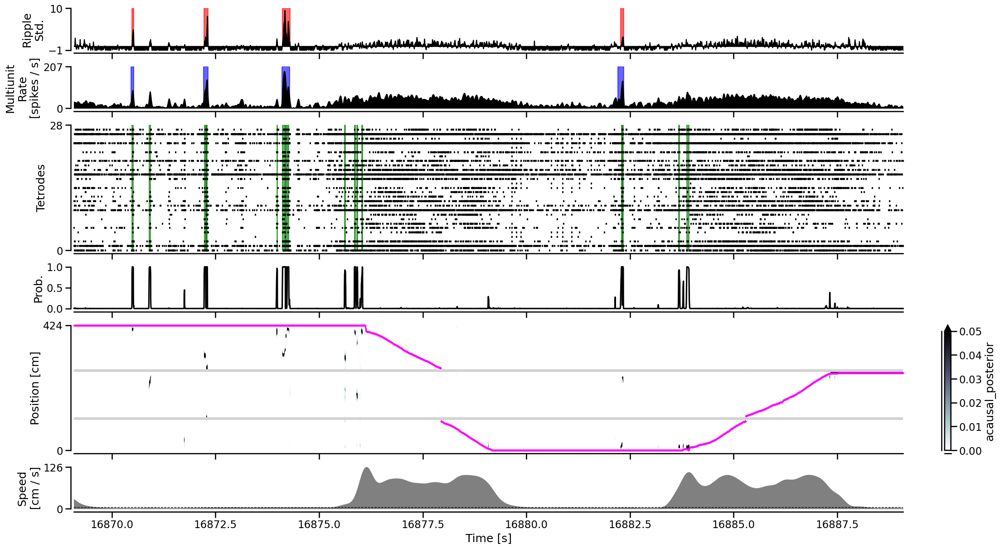

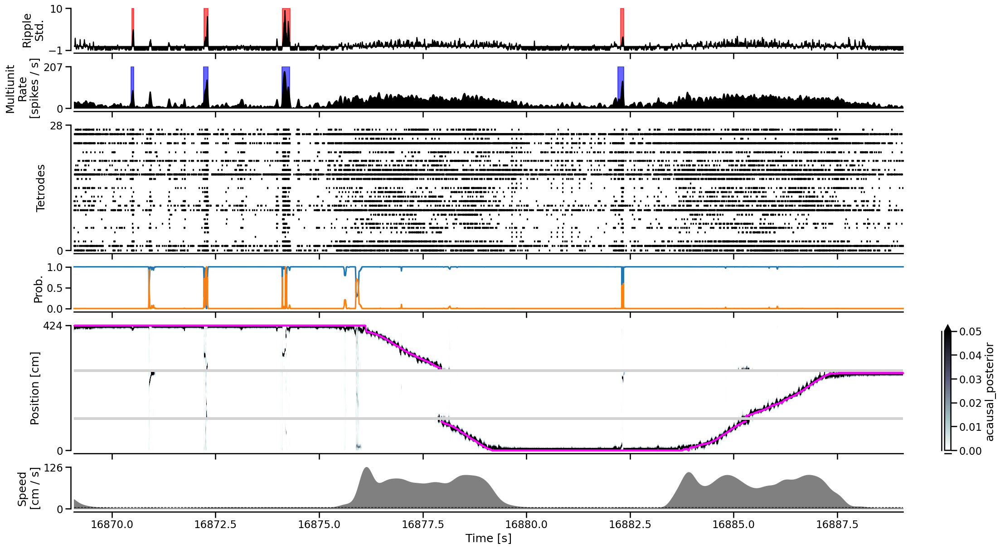

In [228]:
time_slice = slice(250_500, 260_500)
plot_detector(time_slice, data, non_local_detector, non_local_results, figsize=(22, 12.0))
plot_classifier(time_slice, data, classifier, classifier_results, figsize=(22, 12.0))

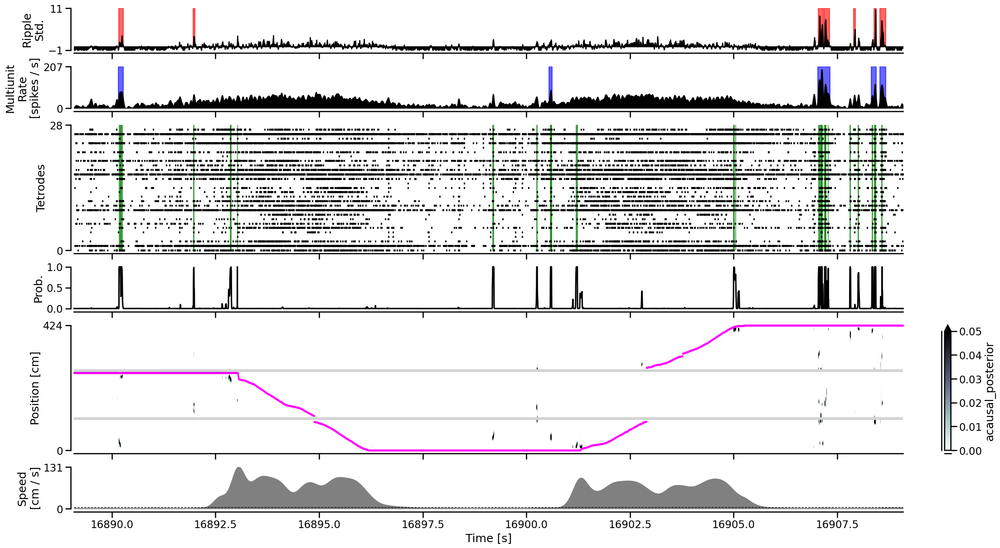

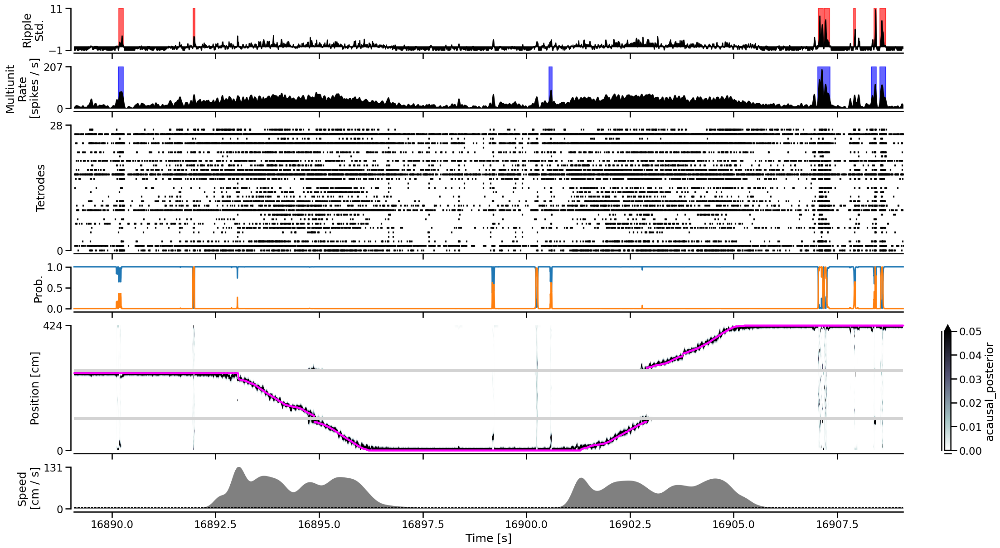

In [229]:
time_slice = slice(260_500, 270_500)
plot_detector(time_slice, data, non_local_detector, non_local_results, figsize=(22, 12.0))
plot_classifier(time_slice, data, classifier, classifier_results, figsize=(22, 12.0))

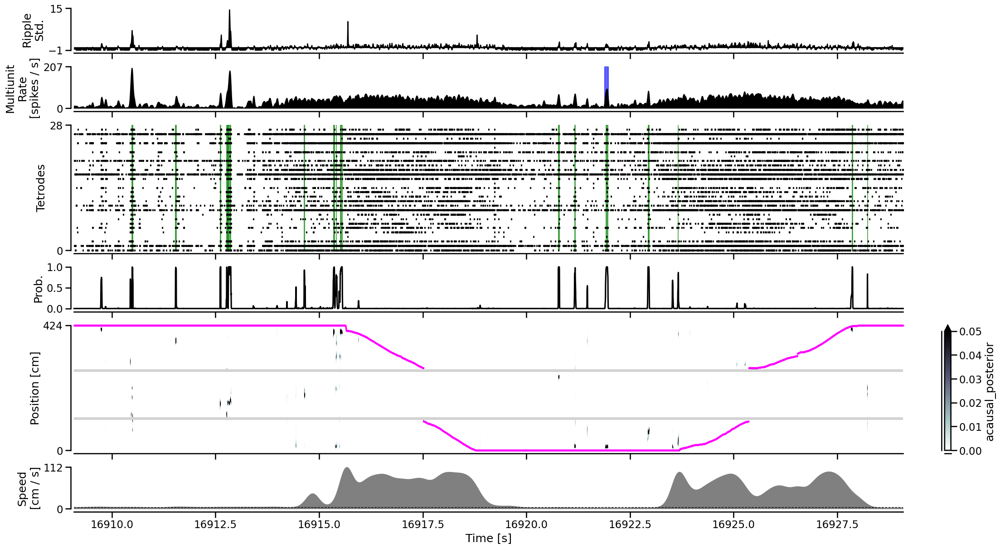

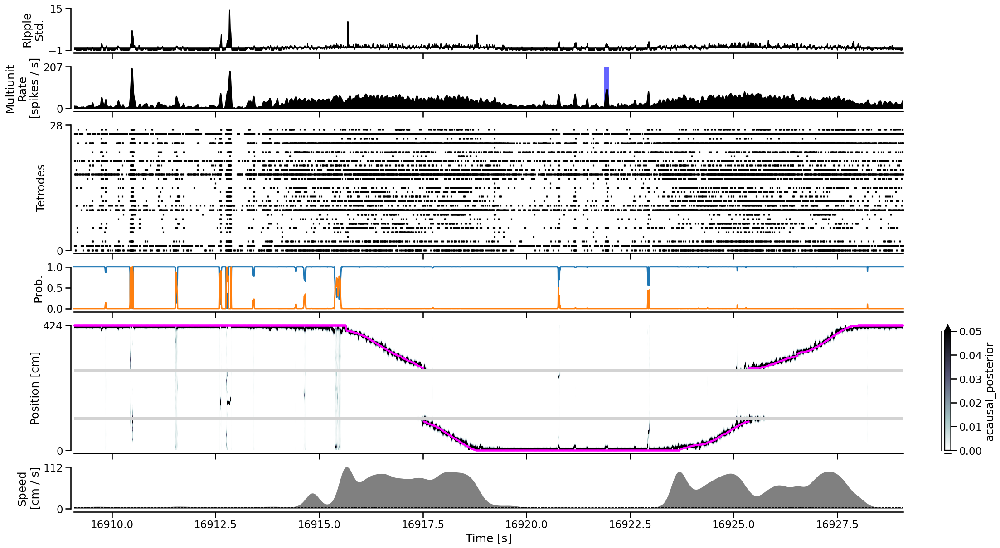

In [230]:
time_slice = slice(270_500, 280_500)
plot_detector(time_slice, data, non_local_detector, non_local_results, figsize=(22, 12.0))
plot_classifier(time_slice, data, classifier, classifier_results, figsize=(22, 12.0))

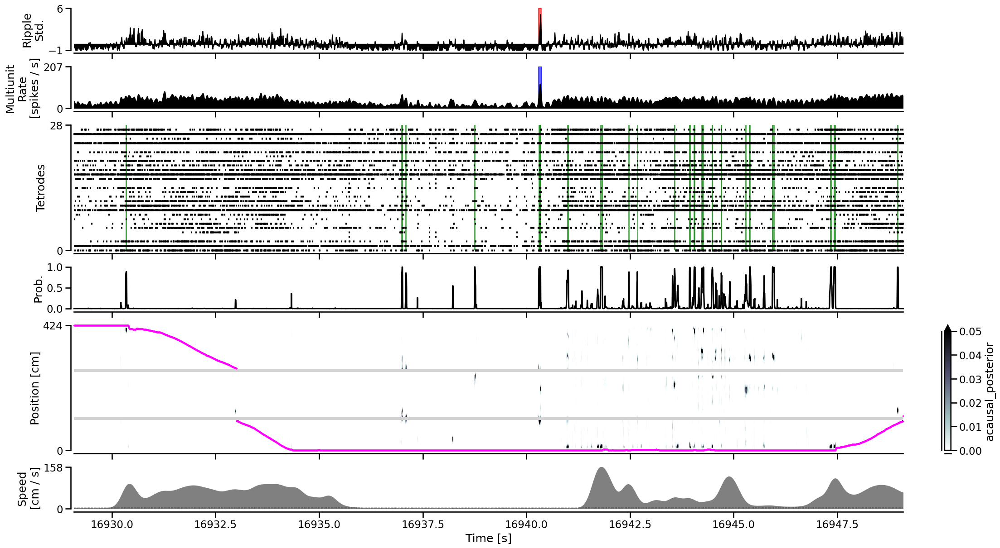

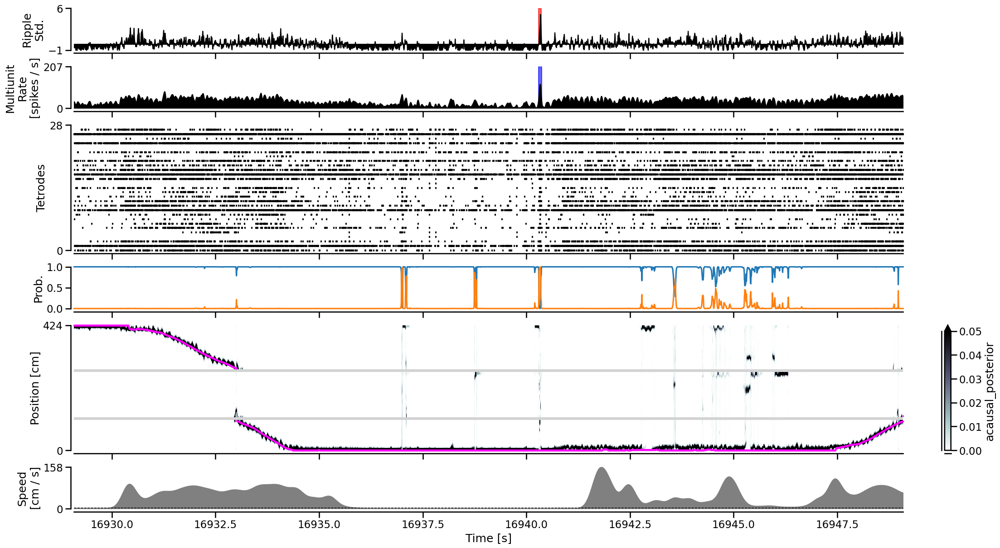

In [231]:
time_slice = slice(280_500, 290_500)
plot_detector(time_slice, data, non_local_detector, non_local_results, figsize=(22, 12.0))
plot_classifier(time_slice, data, classifier, classifier_results, figsize=(22, 12.0))

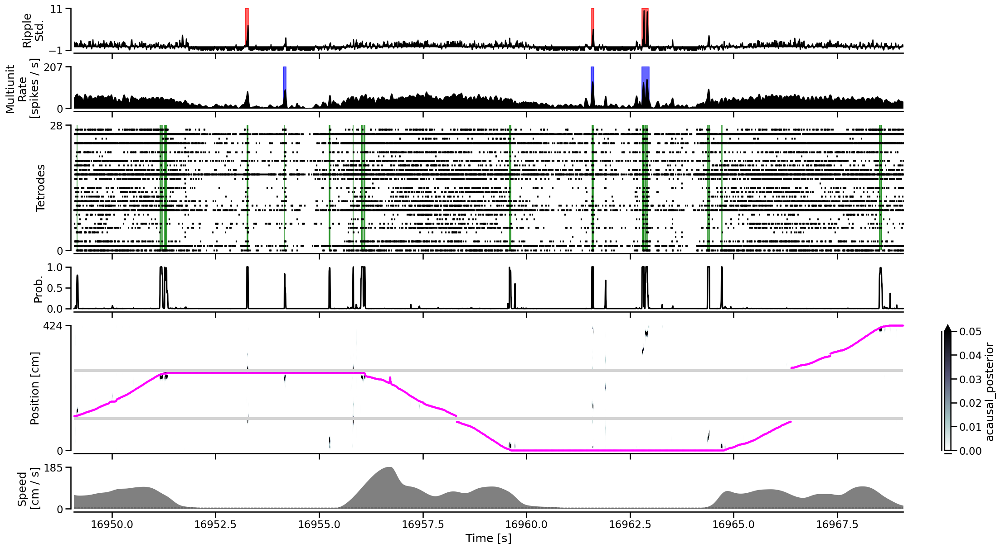

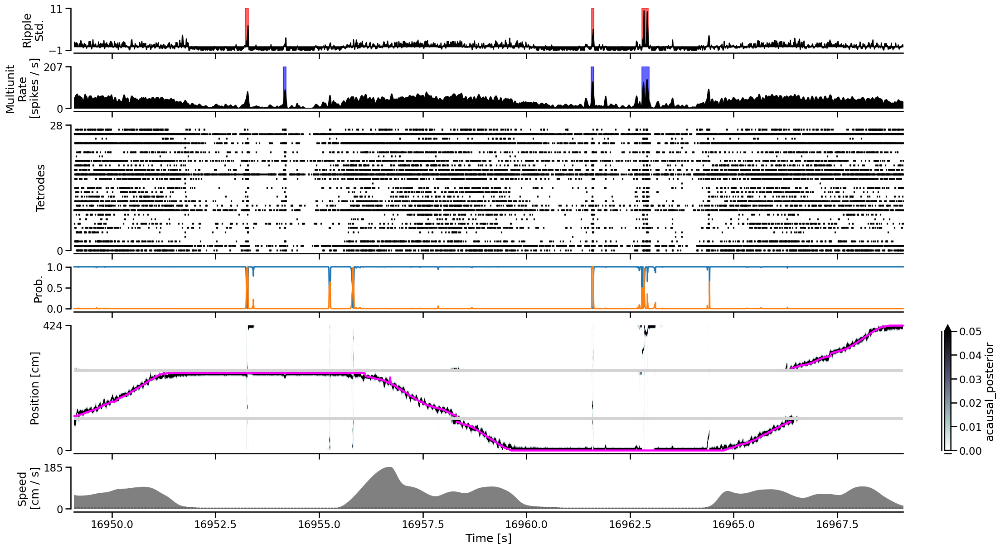

In [232]:
time_slice = slice(290_500, 300_500)
plot_detector(time_slice, data, non_local_detector, non_local_results, figsize=(22, 12.0))
plot_classifier(time_slice, data, classifier, classifier_results, figsize=(22, 12.0))

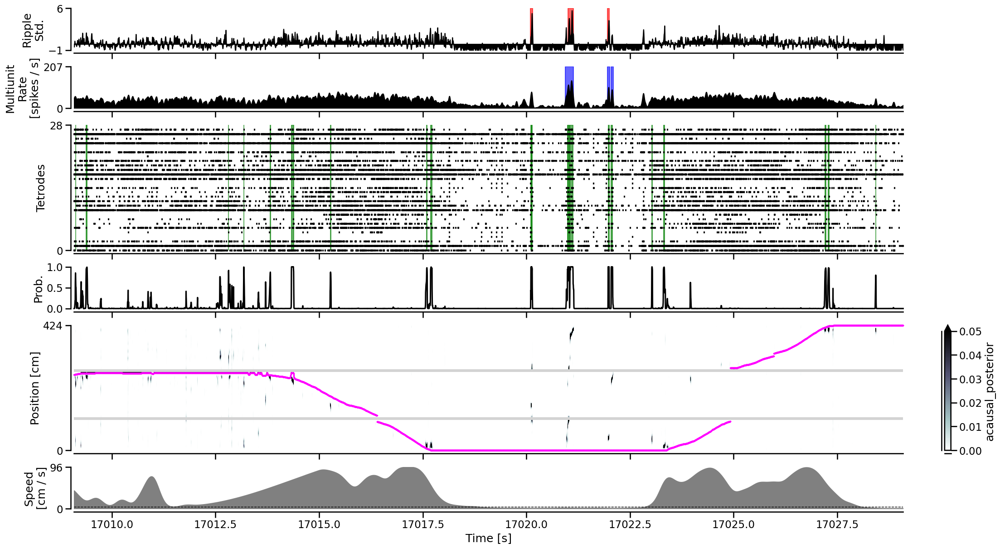

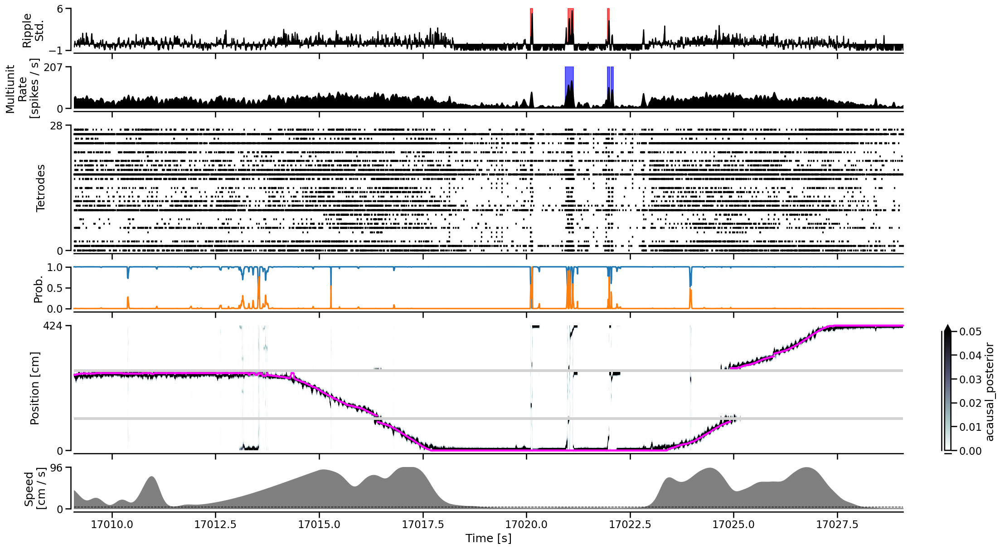

In [235]:
time_slice = slice(320_500, 330_500)
plot_detector(time_slice, data, non_local_detector, non_local_results, figsize=(22, 12.0))
plot_classifier(time_slice, data, classifier, classifier_results, figsize=(22, 12.0))

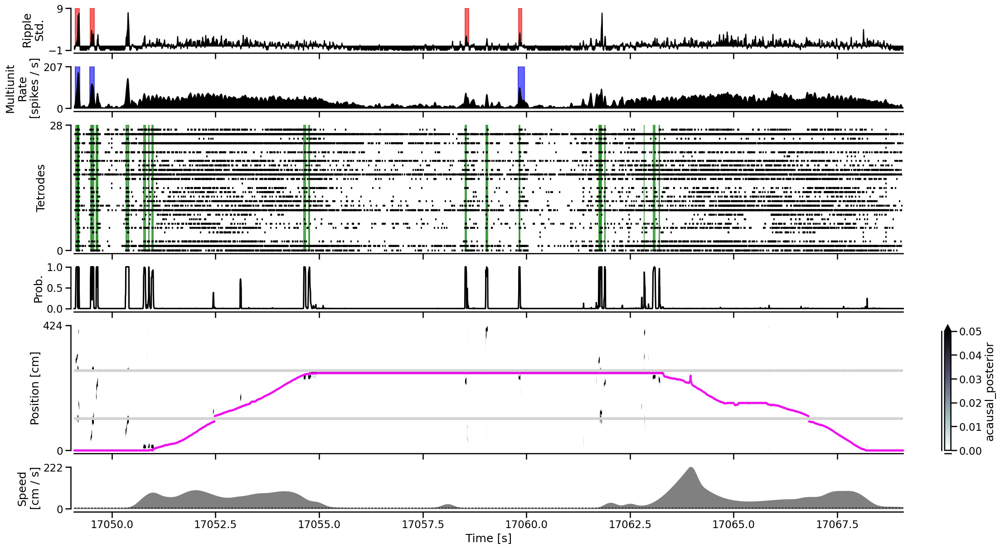

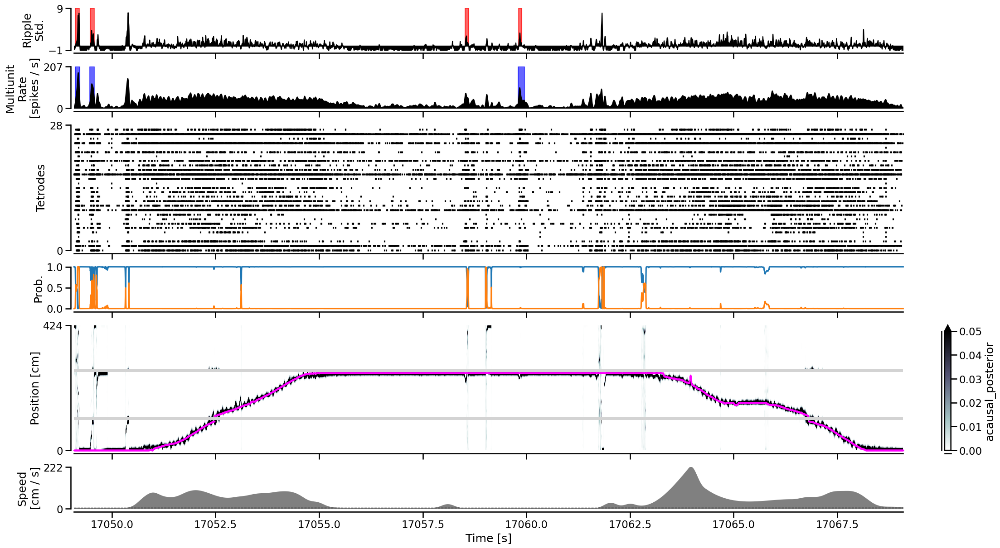

In [237]:
time_slice = slice(340_500, 350_500)
plot_detector(time_slice, data, non_local_detector, non_local_results, figsize=(22, 12.0))
plot_classifier(time_slice, data, classifier, classifier_results, figsize=(22, 12.0))

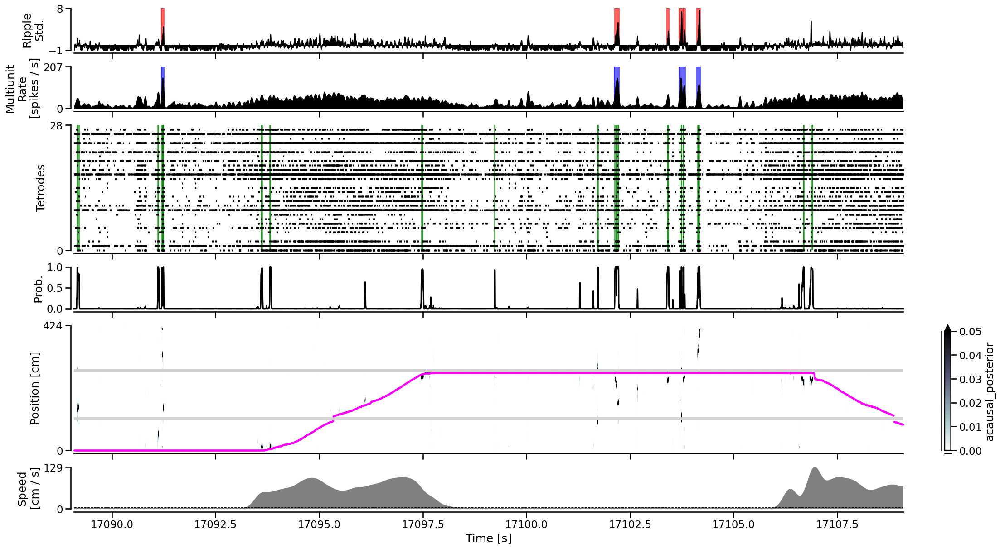

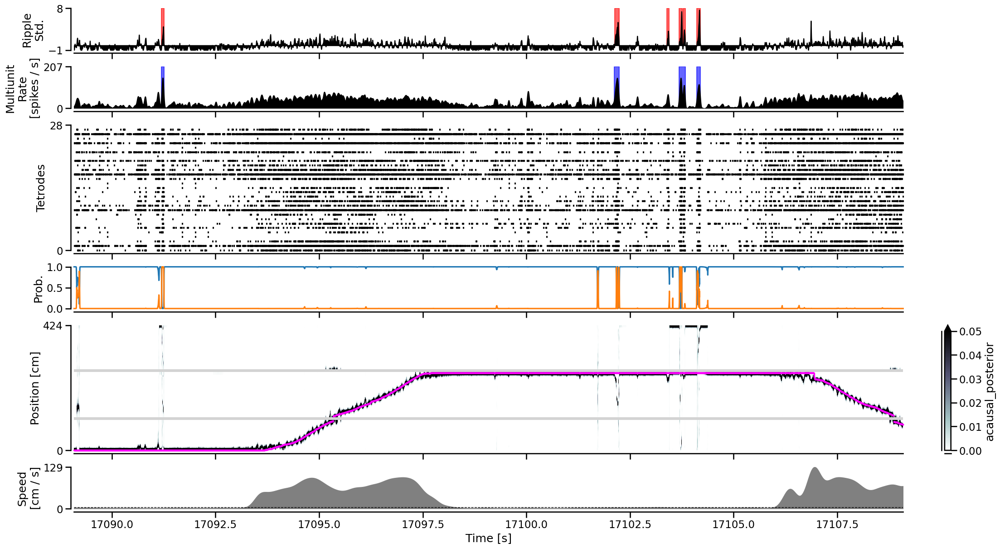

In [239]:
time_slice = slice(360_500, 370_500)
plot_detector(time_slice, data, non_local_detector, non_local_results, figsize=(22, 12.0))
plot_classifier(time_slice, data, classifier, classifier_results, figsize=(22, 12.0))

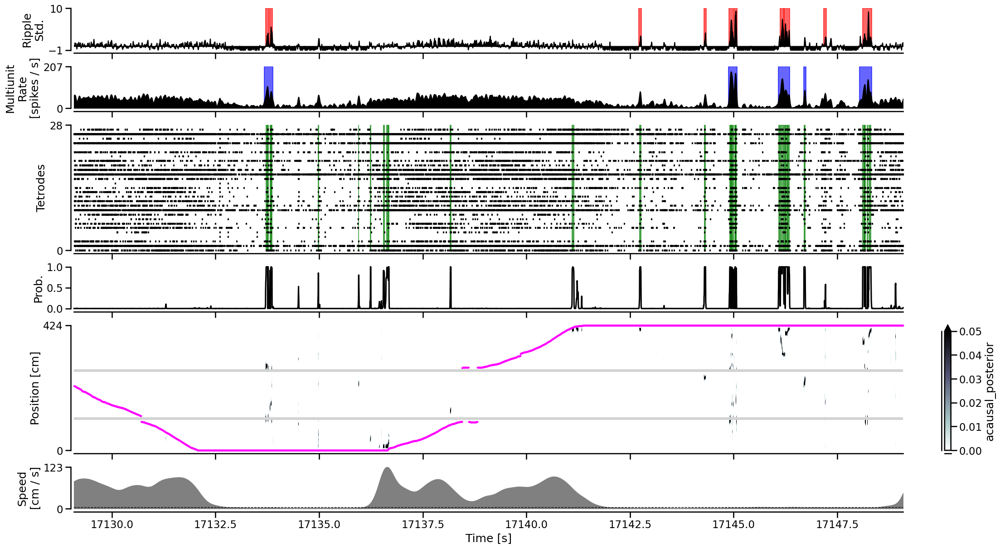

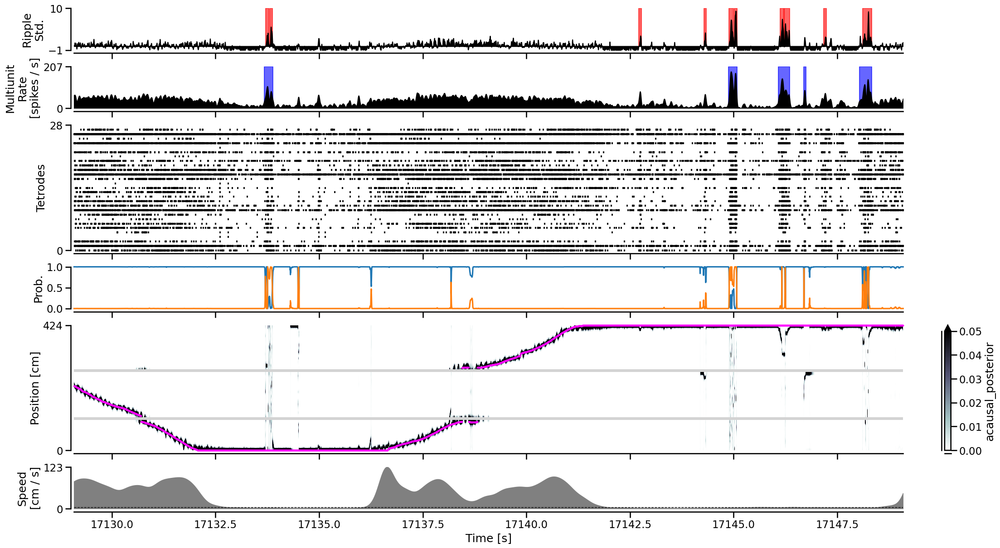

In [240]:
time_slice = slice(380_500, 390_500)
plot_detector(time_slice, data, non_local_detector, non_local_results, figsize=(22, 12.0))
plot_classifier(time_slice, data, classifier, classifier_results, figsize=(22, 12.0))

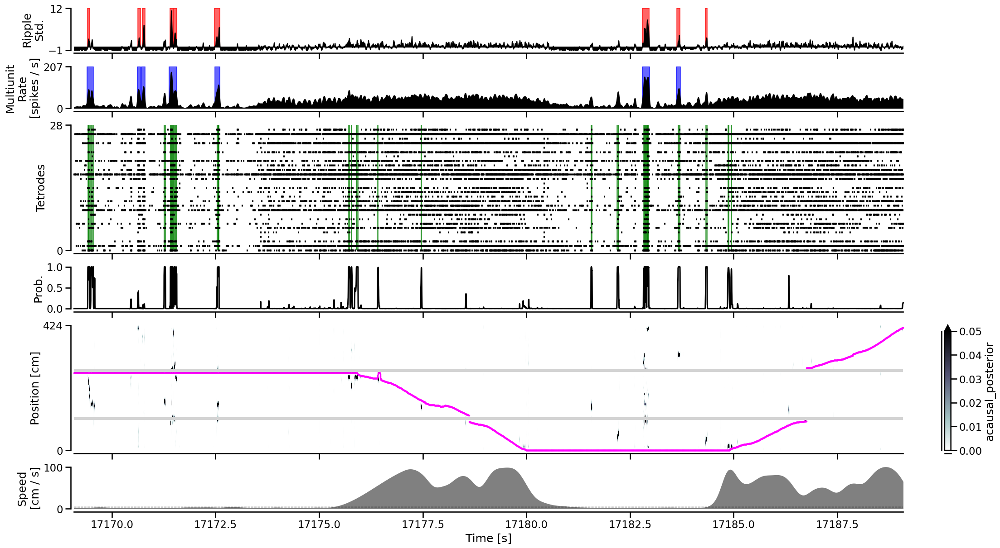

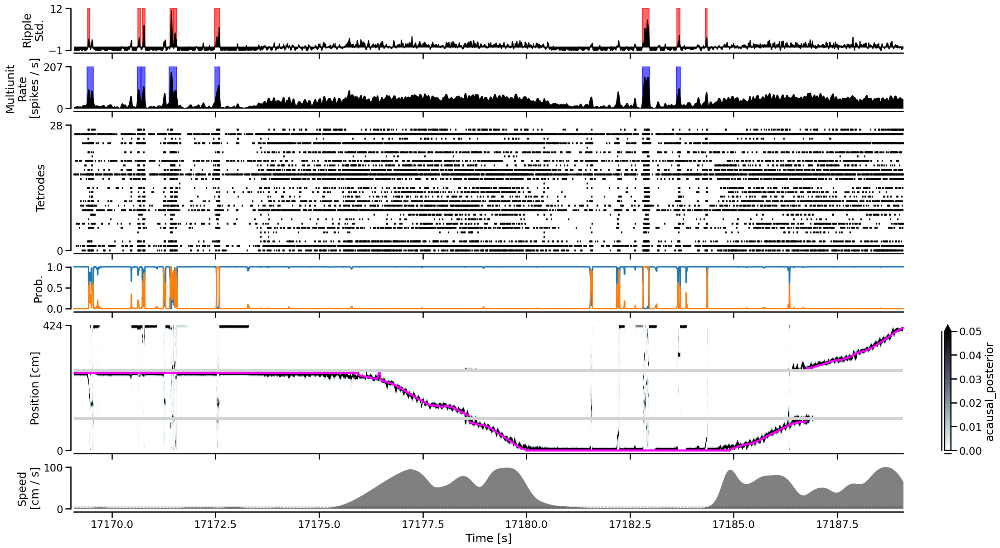

In [242]:
time_slice = slice(400_500, 410_500)
plot_detector(time_slice, data, non_local_detector, non_local_results, figsize=(22, 12.0))
plot_classifier(time_slice, data, classifier, classifier_results, figsize=(22, 12.0))

In [ ]:
non_local_detector